<a href="https://colab.research.google.com/github/j-nat/Facial-Landmark-Detection/blob/main/ResNet50_FacialLandmarks_MicrosoftFakeitDataset10k_RMSE_300W_300VW_WebCam_Dec19.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install facenet-pytorch


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.9 MB 4.8 MB/s 


#Importing Libraries

In [ ]:
import os
import time
import imageio
import numpy as np
from PIL import Image
import cv2
from skimage import io
from tqdm.auto import tqdm
from xml.etree import ElementTree
from matplotlib import pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

import torch
import torchvision
import torchvision.models as models
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms.functional as TF
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from torchsummary import summary
from facenet_pytorch import MTCNN


In [ ]:
# #!wget https://facesyntheticspubwedata.blob.core.windows.net/iccv-2021/dataset_100000.zip
if not os.path.isfile('dataset_1000.zip'):
  !wget https://facesyntheticspubwedata.blob.core.windows.net/iccv-2021/dataset_1000.zip

In [ ]:
if not os.path.exists('dataset_1000'):
  !unzip dataset_1000 -d dataset_1000
  #!unzip /content/drive/MyDrive/dataset_100.zip -d dataset_100

**Mount Drive**

In [ ]:
import shutil
from google.colab import drive
import os
import fileinput
drive.mount('/content/drive', force_remount=True)


Mounted at /content/drive


#Download Data from Blomp

In [ ]:
!wget https://sharedby.blomp.com/m6gEuk

--2022-12-18 19:45:46--  https://sharedby.blomp.com/m6gEuk
Resolving sharedby.blomp.com (sharedby.blomp.com)... 205.134.182.108
Connecting to sharedby.blomp.com (sharedby.blomp.com)|205.134.182.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/octet-stream]
Saving to: ‘m6gEuk’

m6gEuk                  [         <=>        ]   3.11G  6.71MB/s    in 8m 55s  

2022-12-18 19:54:42 (5.97 MB/s) - ‘m6gEuk’ saved [3344464694]



In [ ]:
!unzip m6gEuk -d dataset_10000

Streaming output truncated to the last 5000 lines.
  inflating: dataset_10000/dataset_10000/008334_ldmks.txt  
  inflating: dataset_10000/dataset_10000/008334_seg.png  
  inflating: dataset_10000/dataset_10000/008335.png  
  inflating: dataset_10000/dataset_10000/008335_ldmks.txt  
  inflating: dataset_10000/dataset_10000/008335_seg.png  
  inflating: dataset_10000/dataset_10000/008336.png  
  inflating: dataset_10000/dataset_10000/008336_ldmks.txt  
  inflating: dataset_10000/dataset_10000/008336_seg.png  
  inflating: dataset_10000/dataset_10000/008337.png  
  inflating: dataset_10000/dataset_10000/008337_ldmks.txt  
  inflating: dataset_10000/dataset_10000/008337_seg.png  
  inflating: dataset_10000/dataset_10000/008338.png  
  inflating: dataset_10000/dataset_10000/008338_ldmks.txt  
  inflating: dataset_10000/dataset_10000/008338_seg.png  
  inflating: dataset_10000/dataset_10000/008339.png  
  inflating: dataset_10000/dataset_10000/008339_ldmks.txt  
  inflating: dataset_10000/da

In [ ]:
!mv dataset_10000/dataset_10000  dataset_1000 #the above command generate files in dataset_100000/dataset_100000  move it to dataset_1000 so image path need not change below
print("total_data_set---",len(os.listdir("dataset_1000"))/3) 

total_data_set--- 10001.0


**copy dataset from drive**

In [ ]:
%cp -av /content/drive/MyDrive/ML/DataNew2 dataset_1000

In [ ]:
print("total_data_set---",len(os.listdir('dataset_1000'))/2) 

#Data Augmentations

**Augmentation for face**


In [ ]:
class FaceAugmentation:
    def __init__(self,
                 image_dim,
                 brightness,    
                 contrast,
                 saturation,
                 hue,
                 face_offset,
                 crop_offset):
        
        self.image_dim = image_dim
        self.face_offset = face_offset
        self.crop_offset = crop_offset
        self.transform = transforms.ColorJitter(brightness, contrast, saturation, hue)
    
    def offset_crop(self, image, landmarks, crops_coordinates):
        left = int(float(crops_coordinates['left'])) - self.face_offset
        top = int(float(crops_coordinates['top'])) - self.face_offset
        width = int(float(crops_coordinates['width'])) + (2 * self.face_offset)
        height = int(float(crops_coordinates['height'])) + (2 * self.face_offset)

        image = TF.crop(image, top, left, height, width)
        landmarks = landmarks - np.array([[left, top]])

        new_dim = self.image_dim + self.crop_offset

        image = TF.resize(image, (new_dim, new_dim))

        landmarks[:, 0] *= new_dim / width
        landmarks[:, 1] *= new_dim / height

        return image, landmarks
    
    def random_face_crop(self, image, landmarks):
        image = np.array(image)

        h, w = image.shape[:2]

        top = np.random.randint(0, h - self.image_dim)
        left = np.random.randint(0, w - self.image_dim)

        image = image[top: top + self.image_dim, left: left + self.image_dim]

        landmarks = landmarks - np.array([[left, top]])

        return TF.to_pil_image(image), landmarks
    
    def __call__(self, image, landmarks, crops_coordinates):
        image, landmarks = self.offset_crop(image, landmarks, crops_coordinates)

        image, landmarks = self.random_face_crop(image, landmarks)

        return self.transform(image), landmarks
     



**Augmentation for landmarks**


In [ ]:
class LandmarksAugmentation:
    def __init__(self, rotation_limit):
        self.rotation_limit = rotation_limit

    def random_rotation(self, image, landmarks):
        angle = np.random.uniform(-self.rotation_limit, self.rotation_limit)
        landmarks_transformation = np.array([
            [+np.cos(np.radians(angle)), -np.sin(np.radians(angle))], 
            [+np.sin(np.radians(angle)), +np.cos(np.radians(angle))]
        ])
        image = TF.rotate(image, angle)
        landmarks = landmarks - 0.5
        transformed_landmarks = np.matmul(landmarks, landmarks_transformation)
        transformed_landmarks = transformed_landmarks + 0.5

        return image, transformed_landmarks
    
    def __call__(self, image, landmarks):
        image, landmarks = self.random_rotation(image, landmarks)
        return image, landmarks

#Data Preprocessing


In [ ]:
class Preprocessor:
    def __init__(self,
                 image_dim,
                 brightness,
                 contrast,
                 saturation,
                 hue,
                 angle,
                 face_offset,
                 crop_offset):
        
        self.image_dim = image_dim

        self.landmarks_augmentation = LandmarksAugmentation(angle)
        self.face_augmentation = FaceAugmentation(image_dim, brightness, contrast, saturation, hue, face_offset, crop_offset)
    
    def __call__(self, image, landmarks, crops_coordinates):
        image = TF.to_pil_image(image)

        image, landmarks = self.face_augmentation(image, landmarks, crops_coordinates)

        landmarks = landmarks / np.array([*image.size])

        image, landmarks = self.landmarks_augmentation(image, landmarks)

        image = TF.to_grayscale(image)

        image = TF.to_tensor(image)

        image = (image - image.min())/(image.max() - image.min())
        image = (2 * image) - 1

        return image, torch.FloatTensor(landmarks.reshape(-1) - 0.5)

#Dataset Class


In [ ]:
        
class LandmarksDataset(Dataset):
    def __init__(self, preprocessor, train):
        self.root_dir = '/content/dataset_1000'
        
        self.image_paths = []
        self.landmarks = []
        self.label = []
        self.crops = []
        self.preprocessor = preprocessor
        self.train = train
        #self.face_detector  = dlib.get_frontal_face_detector()
        self.mtcnn = MTCNN()

         
        for filename in os.listdir(self.root_dir):
          if filename.endswith(".txt"):
            label = filename.replace("_ldmks.txt", "")
            img_file = label+".png"
            f1 = os.path.join(self.root_dir, img_file)
            frame = io.imread(f1)
            #faces =  self.face_detector(frame, 1)
            boxes, probs = self.mtcnn.detect(frame, landmarks=False)
            if boxes is  None:
              continue
            if len(boxes>0): 
            #for (i, face) in enumerate(faces):
              #print(i)
              #(x, y, w, h) = face_utils.rect_to_bb(face)
              x=int(float(boxes[0][0]))
              y=int(float(boxes[0][1]))
              w=int(float(boxes[0][2]))-x
              h=int(float(boxes[0][3]))-y
              #cv2.rectangle(frame, (x, y), (x+w,y+h), (0, 255, 0), 2)
              x=int(x-w/6)
              y=int(y-h/6)
              w=int(w+w/3)
              h=int(h+h/3)
              if x<0:
                x=0
              if y<0:
                y=0
              if x+w >frame.shape[1]:
                w=frame.shape[1]-x
              if y+h >frame.shape[0]:
                h=frame.shape[0]-y
                
              #print(x,y,w,h)
              #cv2.rectangle(frame, (x, y), (x+w,y+h), (255, 0, 0), 2)
              self.image_paths.append(f1)
              #crop = {'top': str(x), 'left': str(y), 'width': str(w), 'height': str(h)}
              crop = {'top': str(y), 'left': str(x), 'width': str(w), 'height': str(h)}

              self.crops.append(crop)
              landmark = []
              l_file = os.path.join(self.root_dir, filename)
              with open(l_file) as f:
                for line in f.readlines():
                    line = line.rstrip().split(' ')
                    #print(line)
                    x = int(float(line[0])) 
                    y = int(float(line[1]))
                    landmark.append([x, y])
              self.landmarks.append(landmark)
              self.label.append(label)
            #cv2.imshow('frame', frame)
            #k = cv2.waitKey(0)

        self.landmarks = np.array(self.landmarks).astype('float32')

        assert len(self.image_paths) == len(self.landmarks)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, index):
        image = io.imread(self.image_paths[index], as_gray = False)
        landmarks = self.landmarks[index][:68]
        
        image, landmarks = self.preprocessor(image, landmarks, self.crops[index])

        return image, landmarks

# Some helper functions for visualizing the data


In [ ]:
def visualize_image(image, landmarks):
    plt.figure(figsize = (5, 5))
    image = (image - image.min())/(image.max() - image.min())

    landmarks = landmarks.view(-1, 2)
    landmarks = (landmarks + 0.5) * preprocessor.image_dim

    plt.imshow(image[0], cmap = 'gray')
    plt.scatter(landmarks[:, 0], landmarks[:, 1], s = 25, c = 'dodgerblue')
    plt.axis('off')
    plt.show()
    
def visualize_batch(images_list, landmarks_list, size = 14, shape = (6, 6), title = None, save = None):
    fig = plt.figure(figsize = (size, size))
    grid = ImageGrid(fig, 111, nrows_ncols = shape, axes_pad = 0.08)
    for ax, image, landmarks in zip(grid, images_list, landmarks_list):
        image = (image - image.min())/(image.max() - image.min())
        # image=image.reshape((128,128,3))
        landmarks = landmarks.view(-1, 2)
        landmarks = (landmarks + 0.5) * preprocessor.image_dim
        landmarks = landmarks.numpy().tolist()
        landmarks = np.array([(x, y) for (x, y) in landmarks if 0 <= x <= preprocessor.image_dim and 0 <= y <= preprocessor.image_dim])

        ax.imshow(image[0],cmap='gray')
        # print(landmarks.shape)
        ax.scatter(landmarks[:, 0], landmarks[:, 1], s = 10, c = 'dodgerblue')
        ax.axis('off')

    if title:
        print(title)
    if save:
        plt.savefig(save)
    plt.show()

#Initializing preprocessor, train and test images


In [ ]:
preprocessor = Preprocessor(
    image_dim = 128,
    brightness = 0.24,
    saturation = 0.3,
    contrast = 0.15,
    hue = 0.14,
    angle = 14,
    face_offset = 32,
    crop_offset = 16)

train_images = LandmarksDataset(preprocessor, train = True)
#test_images = LandmarksDataset(preprocessor, train = False)

In [ ]:
import pickle
filehandler=open("pre_processed_10000_data.obj",'wb')
pickle.dump(train_images,filehandler)

In [ ]:
#!cp pre_processed_10000_data.obj /content/drive/MyDrive/ML

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

#Visualizing a sample image, with random augmentations


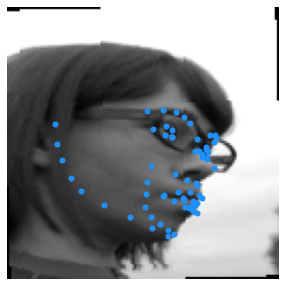

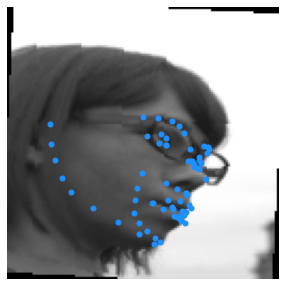

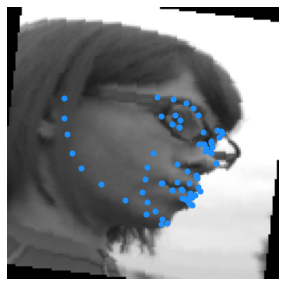

In [ ]:
image1, landmarks1 = train_images[64]
visualize_image(image1, landmarks1)

image2, landmarks2 = train_images[64]
visualize_image(image2, landmarks2)

image3, landmarks3 = train_images[64]
visualize_image(image3, landmarks3)

In [ ]:
len_val_set = int(0.1 * len(train_images))
len_train_set = len(train_images) - len_val_set

print(f'{len_train_set} images for training')
print(f'{len_val_set} images for validating')
# print(f'{len(test_images)} images for testing')

train_images, val_images = random_split(train_images, [len_train_set, len_val_set])

batch_size = 32
train_data = torch.utils.data.DataLoader(train_images, batch_size = batch_size, shuffle = True)
val_data = torch.utils.data.DataLoader(val_images, batch_size =batch_size, shuffle = False)
# test_data = torch.utils.data.DataLoader(test_images, batch_size = 2 * batch_size, shuffle = False)

8649 images for training
960 images for validating


# Visualizing a sample batch


torch.Size([32, 1, 128, 128]) torch.Size([32, 136]) tensor(1.) tensor(-1.) tensor(0.5181) tensor(-0.4551)
torch.Size([32, 1, 128, 128]) torch.Size([32, 136]) tensor(1.) tensor(-1.) tensor(0.4414) tensor(-0.4235)
Training Batch Samples


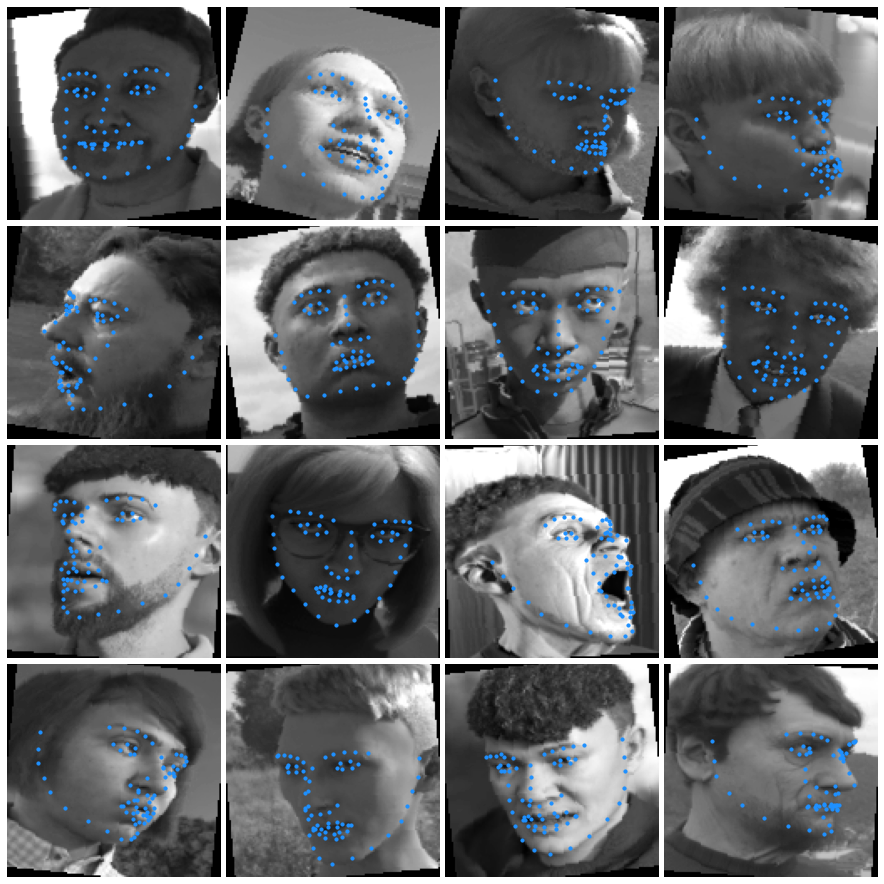

In [ ]:
for x, y in train_data:
    break

print(x.shape, y.shape, x.max(), x.min(), y.max(), y.min())

for x, y in val_data:
    break

print(x.shape, y.shape, x.max(), x.min(), y.max(), y.min())
visualize_batch(x[:16], y[:16], shape = (4, 4), size = 16, title = 'Training Batch Samples')


#ResNet50


In [ ]:
class Network(nn.Module):
    def __init__(self,num_classes=136):
        super().__init__()
        self.weights = models.ResNet50_Weights.DEFAULT
        self.model_name='resnet50'
        self.model=models.resnet50(weights=self.weights)
        self.model.conv1=nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
        self.model.fc=nn.Linear(self.model.fc.in_features, num_classes)
        self.a=nn.Tanh()
    def forward(self, x):
        x=self.model(x)
        return self.a(x)

In [ ]:
model = Network()
model.cuda()

#Xceptionet


In [ ]:
class DepthewiseSeperableConv2d(nn.Module):
    def __init__(self, input_channels, output_channels, kernel_size, **kwargs):
        super(DepthewiseSeperableConv2d, self).__init__()

        self.depthwise = nn.Conv2d(input_channels, input_channels, kernel_size, groups = input_channels, bias = False, **kwargs)
        self.pointwise = nn.Conv2d(input_channels, output_channels, 1, bias = False)

    def forward(self, x):
        x = self.depthwise(x)
        x = self.pointwise(x)

        return x

In [ ]:
class EntryBlock(nn.Module):
    def __init__(self):
        super(EntryBlock, self).__init__()

        self.conv1 = nn.Sequential(
            nn.Conv2d(1, 32, 3, padding = 1, bias = False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2)
        )

        self.conv2 = nn.Sequential(
            nn.Conv2d(32, 64, 3, padding = 1, bias = False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2)
        )

        self.conv3_residual = nn.Sequential(
            DepthewiseSeperableConv2d(64, 64, 3, padding = 1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(64, 128, 3, padding = 1),
            nn.BatchNorm2d(128),
            nn.MaxPool2d(3, stride = 2, padding = 1),
        )

        self.conv3_direct = nn.Sequential(
            nn.Conv2d(64, 128, 1, stride = 2),
            nn.BatchNorm2d(128),
        )

        self.conv4_residual = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(128, 128, 3, padding = 1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(128, 256, 3, padding = 1),
            nn.BatchNorm2d(256),
            nn.MaxPool2d(3, stride = 2, padding = 1)
        )

        self.conv4_direct = nn.Sequential(
            nn.Conv2d(128, 256, 1, stride = 2),
            nn.BatchNorm2d(256),
        )

    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)

        residual = self.conv3_residual(x)
        direct = self.conv3_direct(x)
        x = residual + direct
        
        residual = self.conv4_residual(x)
        direct = self.conv4_direct(x)
        x = residual + direct

        return x

In [ ]:
class MiddleBasicBlock(nn.Module):
    def __init__(self):
        super(MiddleBasicBlock, self).__init__()

        self.conv1 = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256)
        )
        self.conv2 = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256)
        )
        self.conv3 = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256)
        )

    def forward(self, x):
        residual = self.conv1(x)
        residual = self.conv2(residual)
        residual = self.conv3(residual)

        return x + residual


class MiddleBlock(nn.Module):
    def __init__(self, num_blocks):
        super().__init__()

        self.block = nn.Sequential(*[MiddleBasicBlock() for _ in range(num_blocks)])

    def forward(self, x):
        x = self.block(x)

        return x

In [ ]:
class ExitBlock(nn.Module):
    def __init__(self):
        super(ExitBlock, self).__init__()

        self.residual = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 512, 3, padding = 1),
            nn.BatchNorm2d(512),
            nn.MaxPool2d(3, stride = 2, padding = 1)
        )

        self.direct = nn.Sequential(
            nn.Conv2d(256, 512, 1, stride = 2),
            nn.BatchNorm2d(512)
        )

        self.conv = nn.Sequential(
            DepthewiseSeperableConv2d(512, 512, 3, padding = 1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(512, 1024, 3, padding = 1),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2)
        )

        self.dropout = nn.Dropout(0.3)

        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))

    def forward(self, x):
        direct = self.direct(x)
        residual = self.residual(x)
        x = direct + residual
        
        x = self.conv(x)
        x = self.avgpool(x)
        x = self.dropout(x)

        return x

In [ ]:
class XceptionNet(nn.Module):
    def __init__(self, num_middle_blocks = 6):
        super(XceptionNet, self).__init__()

        self.entry_block = EntryBlock()
        self.middel_block = MiddleBlock(num_middle_blocks)
        self.exit_block = ExitBlock()

        self.fc = nn.Linear(1024, 136)

    def forward(self, x):
        x = self.entry_block(x)
        x = self.middel_block(x)
        x = self.exit_block(x)

        x = x.view(x.size(0), -1)
        
        x = self.fc(x)

        return x

In [ ]:
#model = XceptionNet()
#model.cuda()

#Initializing the objective loss and optimizer


In [ ]:
from sklearn.metrics import mean_squared_error
from math import sqrt

class RMSELoss(nn.Module):
    def __init__(self,  eps=1e-6):
        super().__init__()
        self.mse = nn.MSELoss()
        self.eps = eps
        
    def forward(self,yhat,y):
        return torch.sqrt(self.mse(yhat,y)+ self.eps)

objective = RMSELoss()
optimizer = optim.Adam(model.parameters(), lr = 0.0001)

#Defining validation function


Validation sample predictions


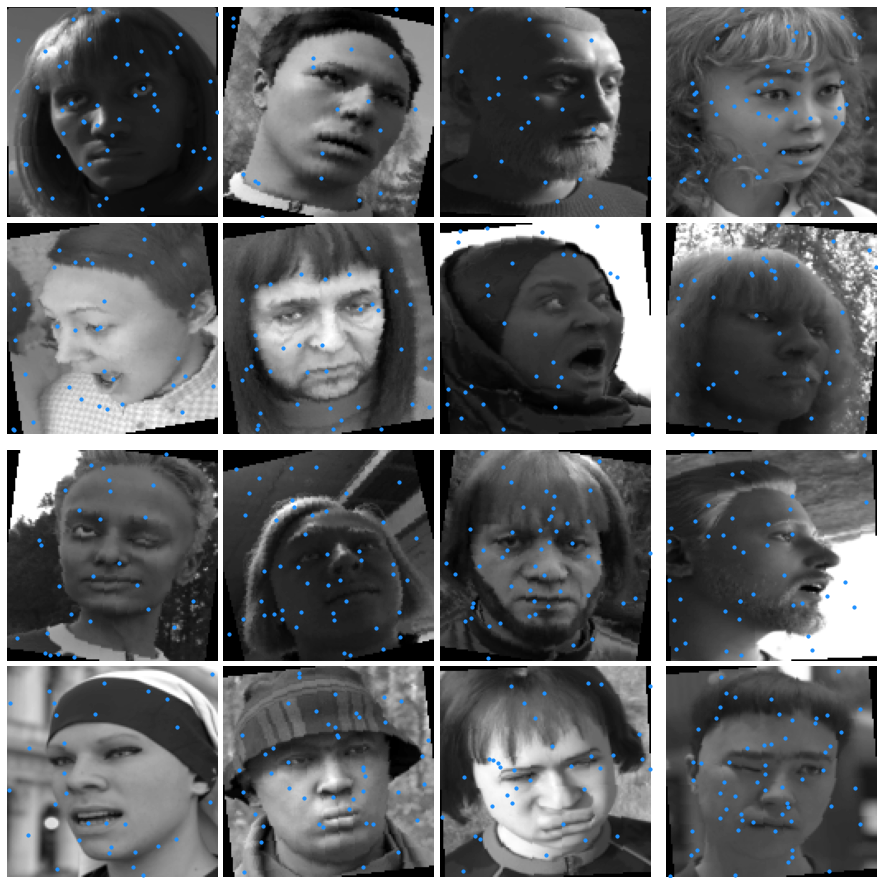

tensor(0.4965, device='cuda:0')

In [ ]:
@torch.no_grad()
def validate(save = None):
    cum_loss = 0.0

    model.eval()
    imgb=[]
    lb=[]
    for features, labels in val_data:
          imgs = features.cuda()
          labels = labels.cuda()
          # weights = models.ResNet50_Weights.DEFAULT
          # preprocess = weights.transforms()
          # imgs = preprocess(features.cuda())
          outputs = model(imgs)
          # print(imgs.shape)
          #outputs = outputs.cpu()
          #labels = labels.cpu()
          loss = objective(outputs, labels)
          cum_loss += loss
          
          #cum_loss += loss.item()
          imgb=imgs.cpu()
          lb=outputs.cpu()
          
    visualize_batch(imgb[:16], lb[:16], shape = (4, 4), size = 16, title = 'Validation sample predictions', save = save)

    return cum_loss/len(val_data)

validate()
     

#Creating directory for storing the model's progress


In [ ]:
if os.path.isdir('progress'):
    !rm -rf progress
os.mkdir('progress')
     

#Training the model


Epoch(1/100):   0%|                                                                                           …

Validation sample predictions


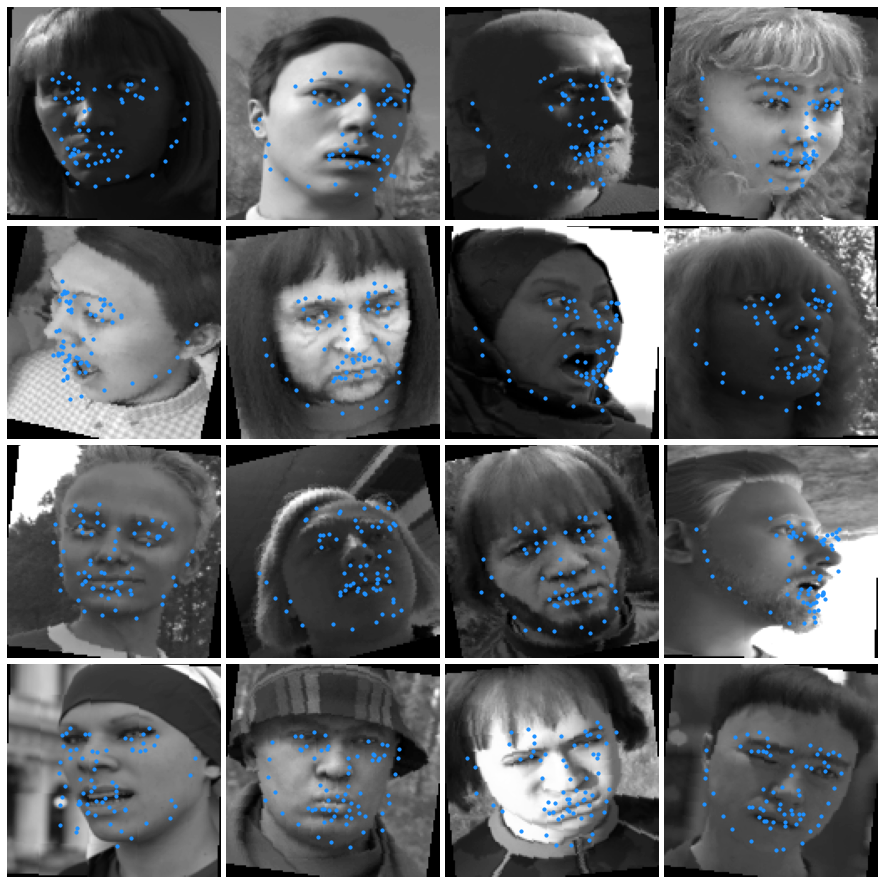

Saving model....................

Minimum Validation Loss of 0.0594 at epoch 0/100
Model Saved

Epoch(1/100) -> Training Loss: 0.10836974 | Validation Loss: 0.05941851


Epoch(2/100):   0%|                                                                                           …

Validation sample predictions


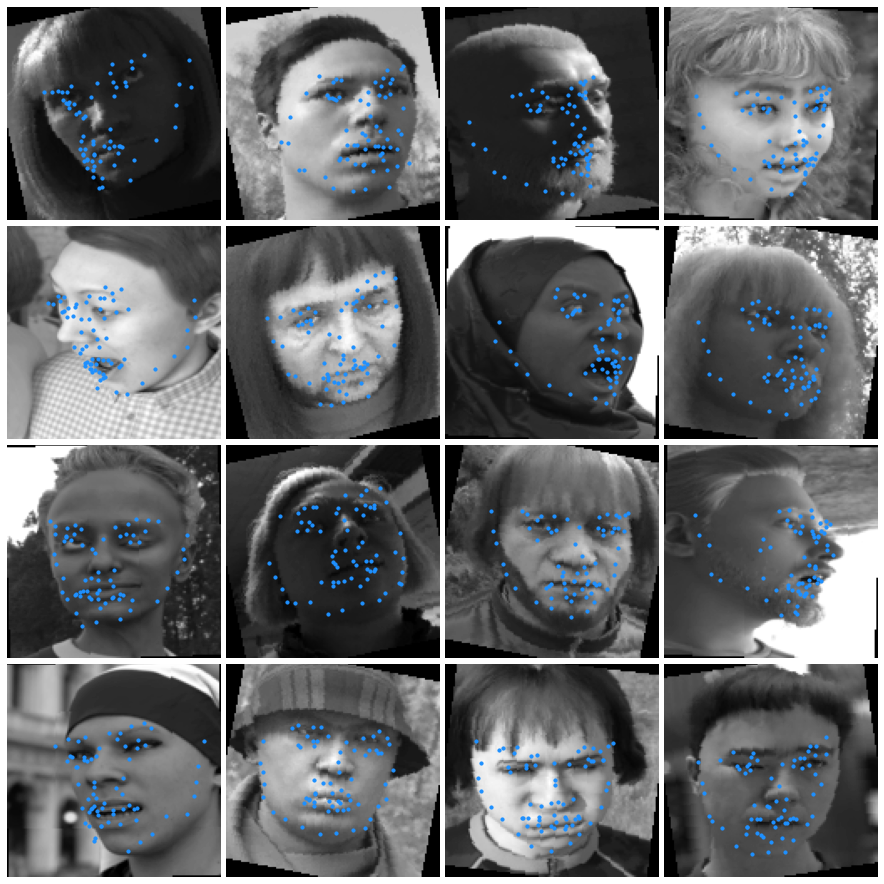

Saving model....................

Minimum Validation Loss of 0.0465 at epoch 1/100
Model Saved

Epoch(2/100) -> Training Loss: 0.06385058 | Validation Loss: 0.04651365


Epoch(3/100):   0%|                                                                                           …

Validation sample predictions


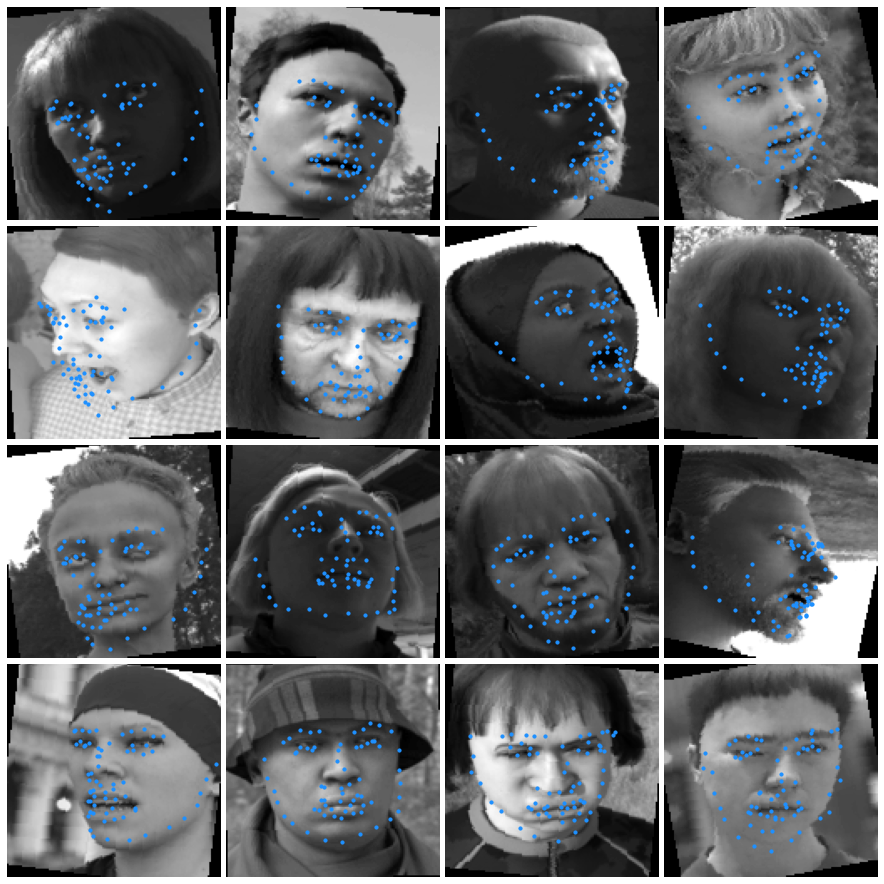

Saving model....................

Minimum Validation Loss of 0.0407 at epoch 2/100
Model Saved

Epoch(3/100) -> Training Loss: 0.05522706 | Validation Loss: 0.04073333


Epoch(4/100):   0%|                                                                                           …

Validation sample predictions


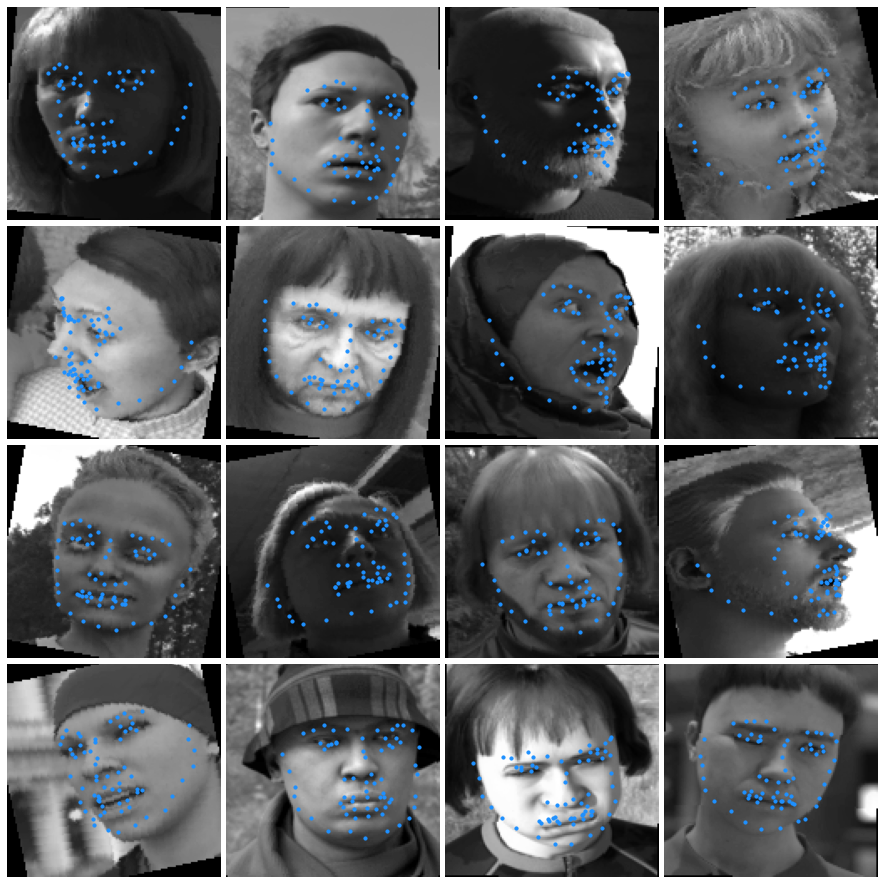

Saving model....................

Minimum Validation Loss of 0.0360 at epoch 3/100
Model Saved

Epoch(4/100) -> Training Loss: 0.05103124 | Validation Loss: 0.03598367


Epoch(5/100):   0%|                                                                                           …

Validation sample predictions


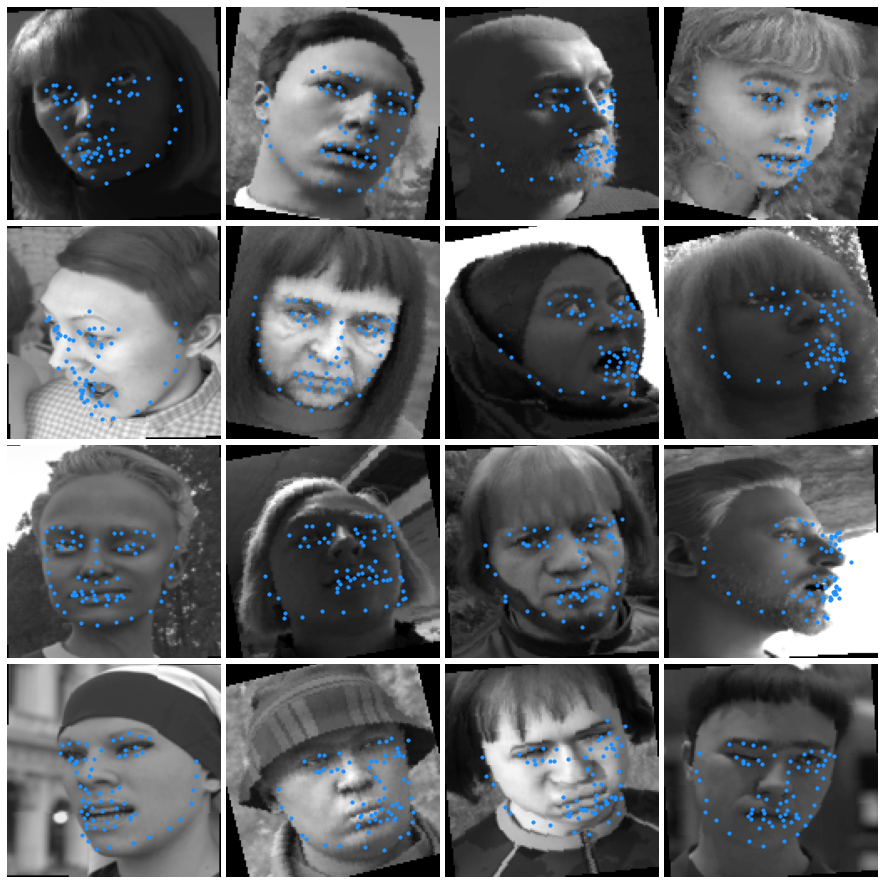

Epoch(5/100) -> Training Loss: 0.04826137 | Validation Loss: 0.03850703


Epoch(6/100):   0%|                                                                                           …

Validation sample predictions


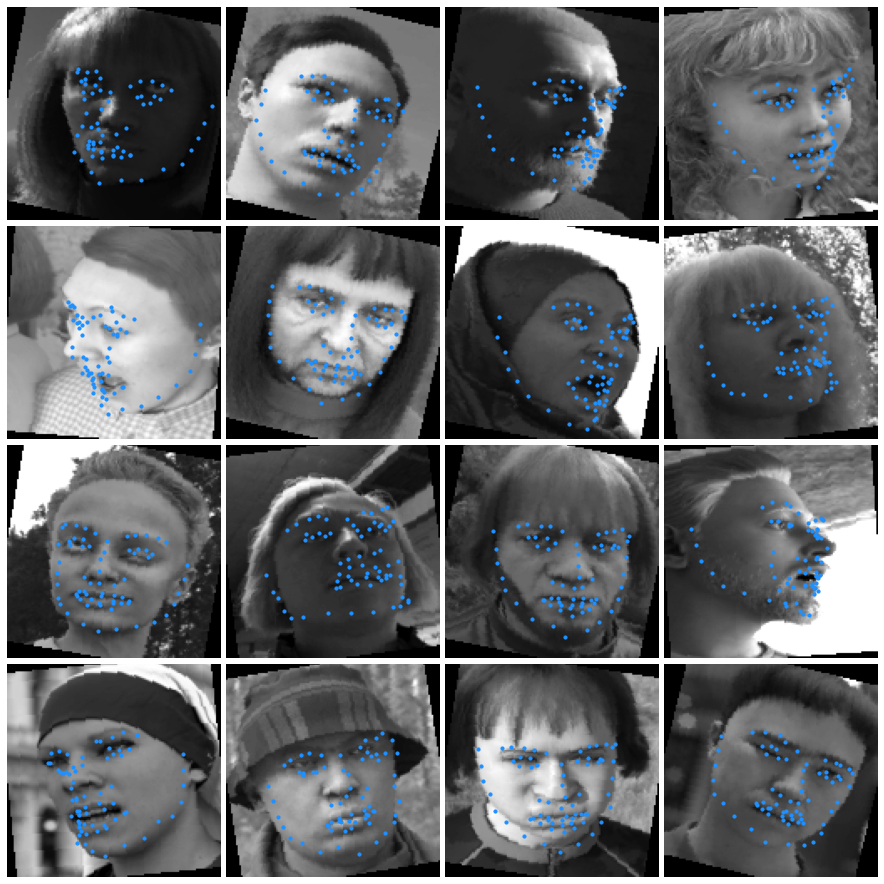

Saving model....................

Minimum Validation Loss of 0.0358 at epoch 5/100
Model Saved

Epoch(6/100) -> Training Loss: 0.04790482 | Validation Loss: 0.03580102


Epoch(7/100):   0%|                                                                                           …

Validation sample predictions


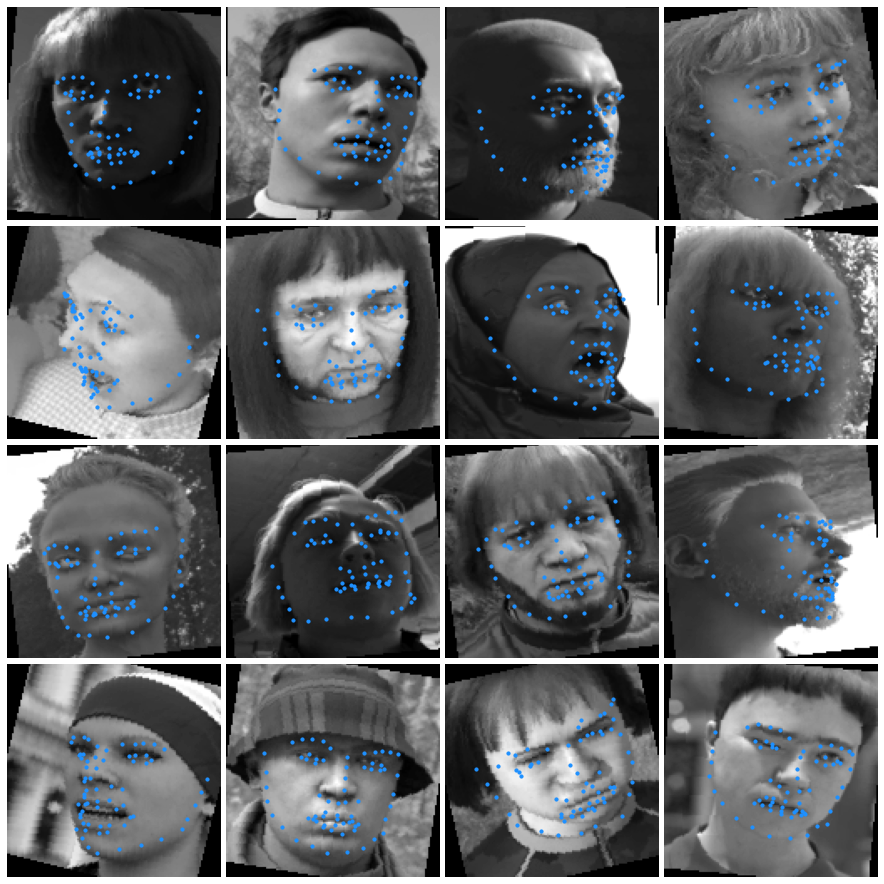

Saving model....................

Minimum Validation Loss of 0.0327 at epoch 6/100
Model Saved

Epoch(7/100) -> Training Loss: 0.04433395 | Validation Loss: 0.03265867


Epoch(8/100):   0%|                                                                                           …

Validation sample predictions


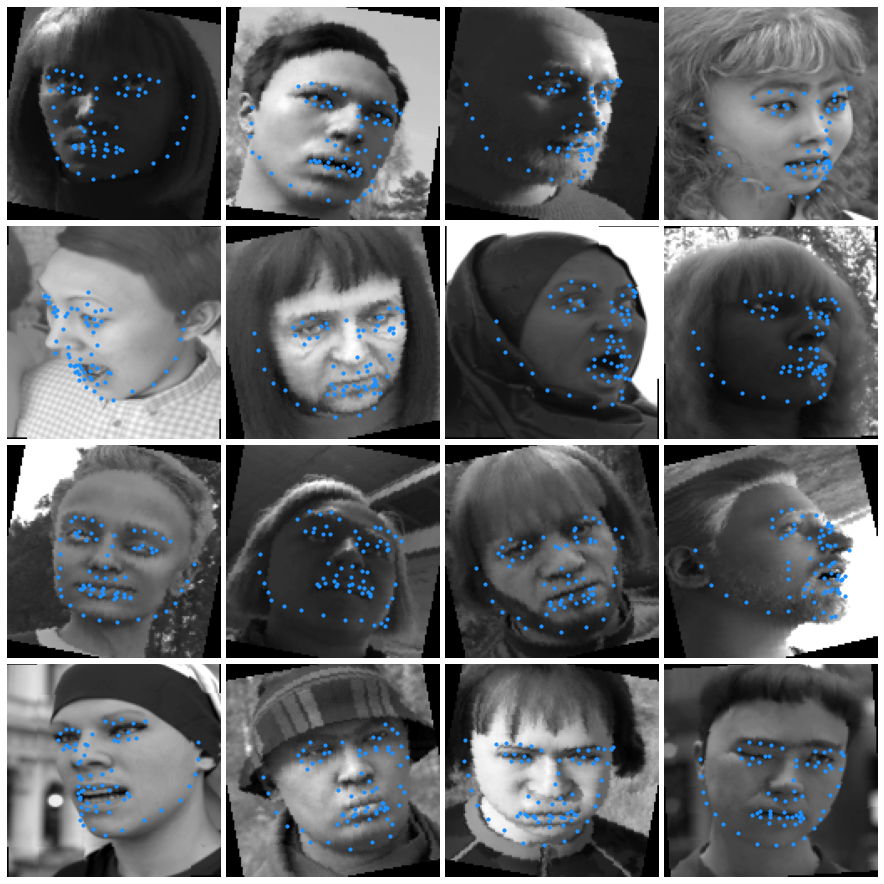

Epoch(8/100) -> Training Loss: 0.04093499 | Validation Loss: 0.03347204


Epoch(9/100):   0%|                                                                                           …

Validation sample predictions


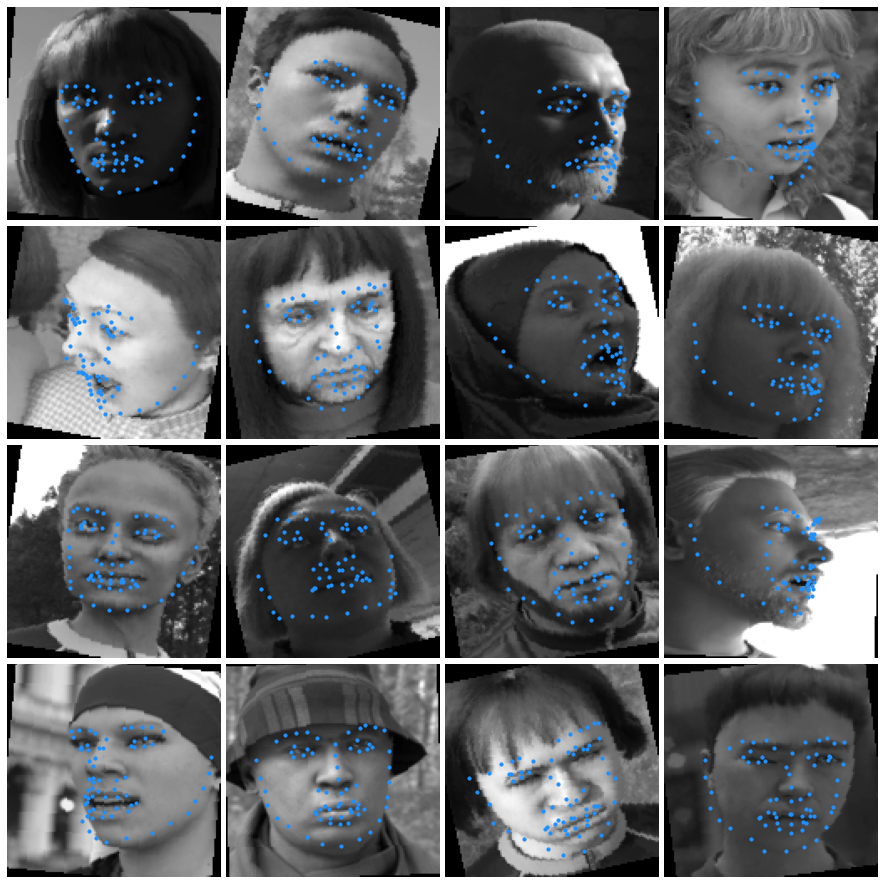

Saving model....................

Minimum Validation Loss of 0.0319 at epoch 8/100
Model Saved

Epoch(9/100) -> Training Loss: 0.03905463 | Validation Loss: 0.03187784


Epoch(10/100):   0%|                                                                                          …

Validation sample predictions


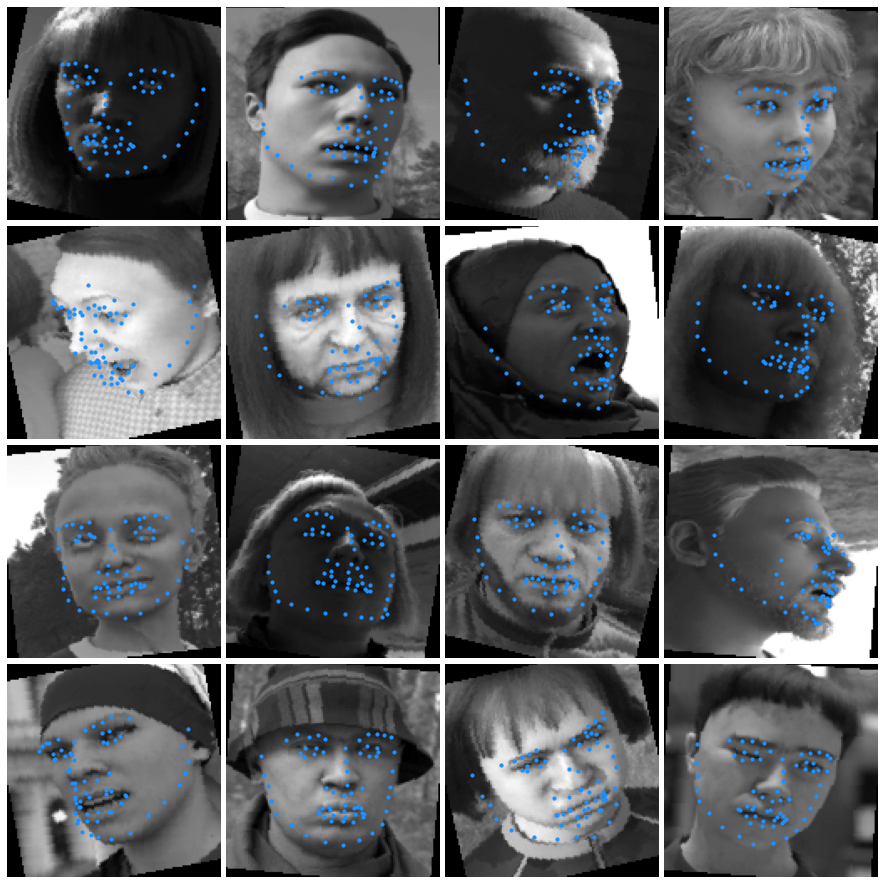

Saving model....................

Minimum Validation Loss of 0.0274 at epoch 9/100
Model Saved

Epoch(10/100) -> Training Loss: 0.03890703 | Validation Loss: 0.02739499


Epoch(11/100):   0%|                                                                                          …

Validation sample predictions


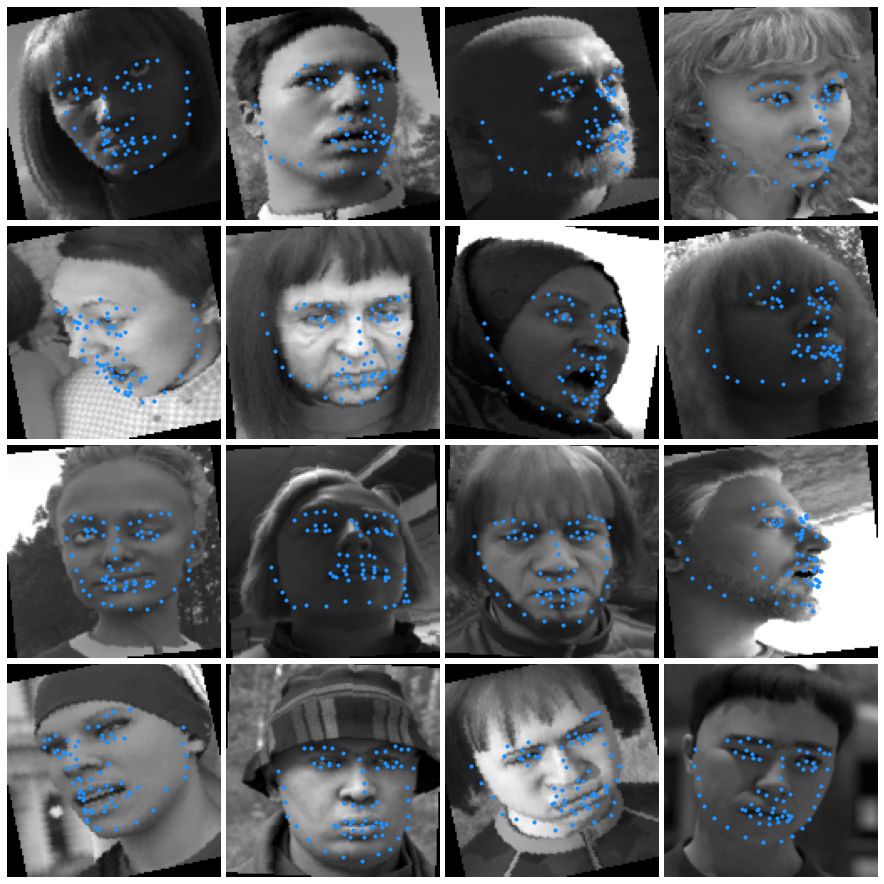

Epoch(11/100) -> Training Loss: 0.03743378 | Validation Loss: 0.03269628


Epoch(12/100):   0%|                                                                                          …

Validation sample predictions


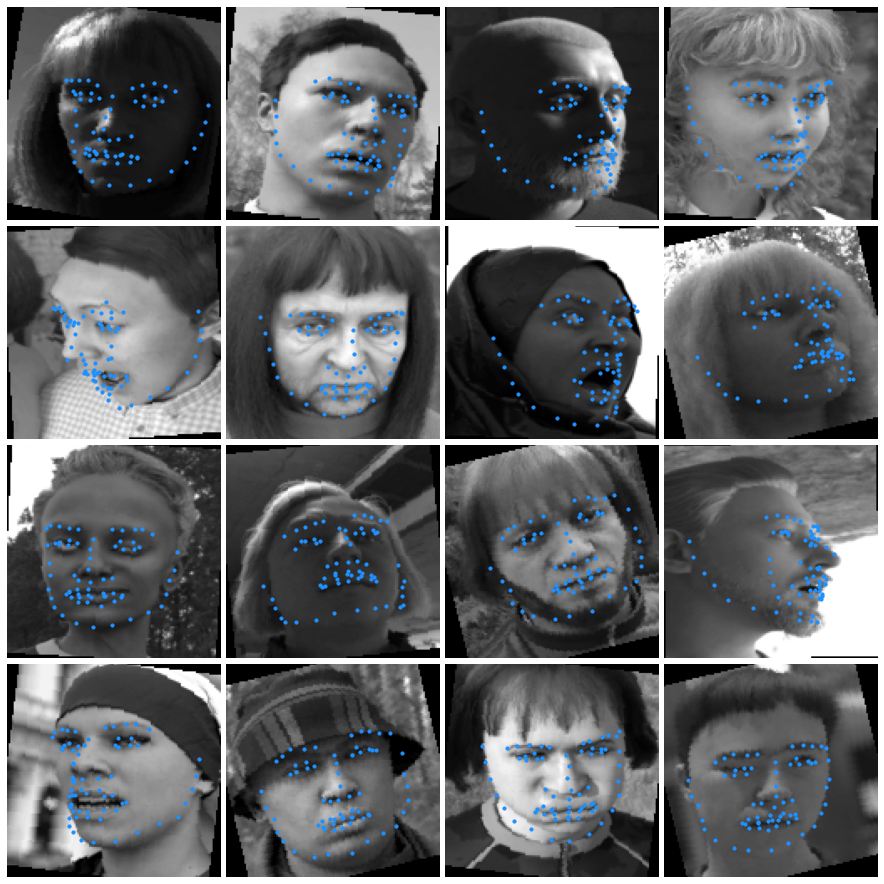

Epoch(12/100) -> Training Loss: 0.03624120 | Validation Loss: 0.02820542


Epoch(13/100):   0%|                                                                                          …

Validation sample predictions


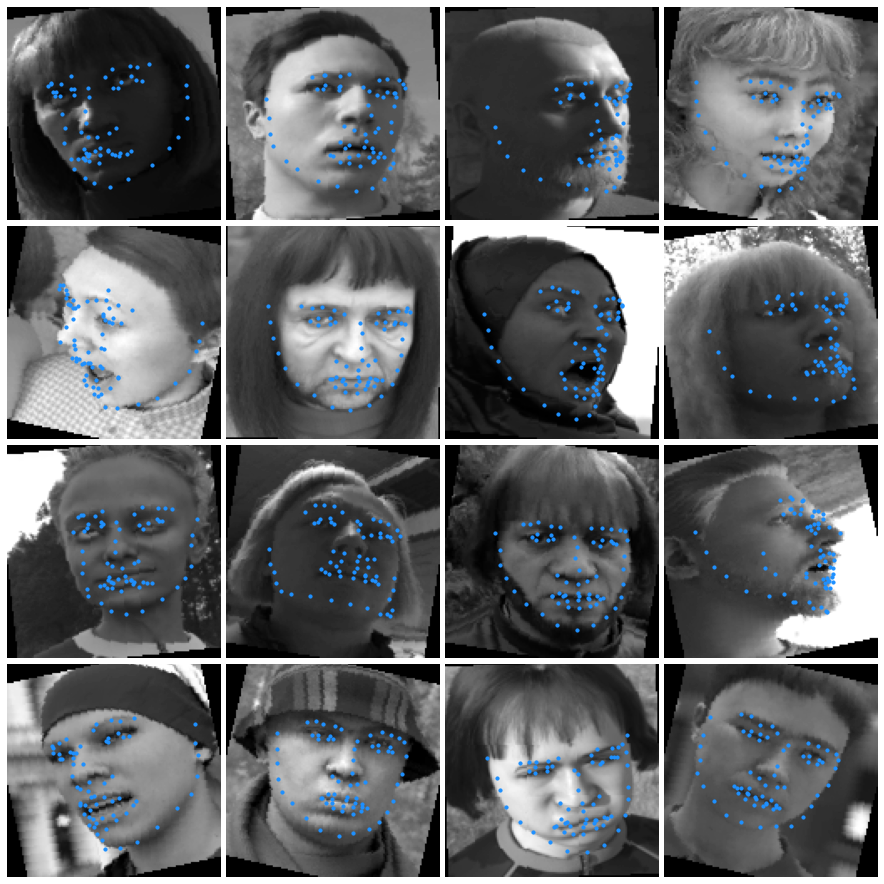

Epoch(13/100) -> Training Loss: 0.03529116 | Validation Loss: 0.02881678


Epoch(14/100):   0%|                                                                                          …

Validation sample predictions


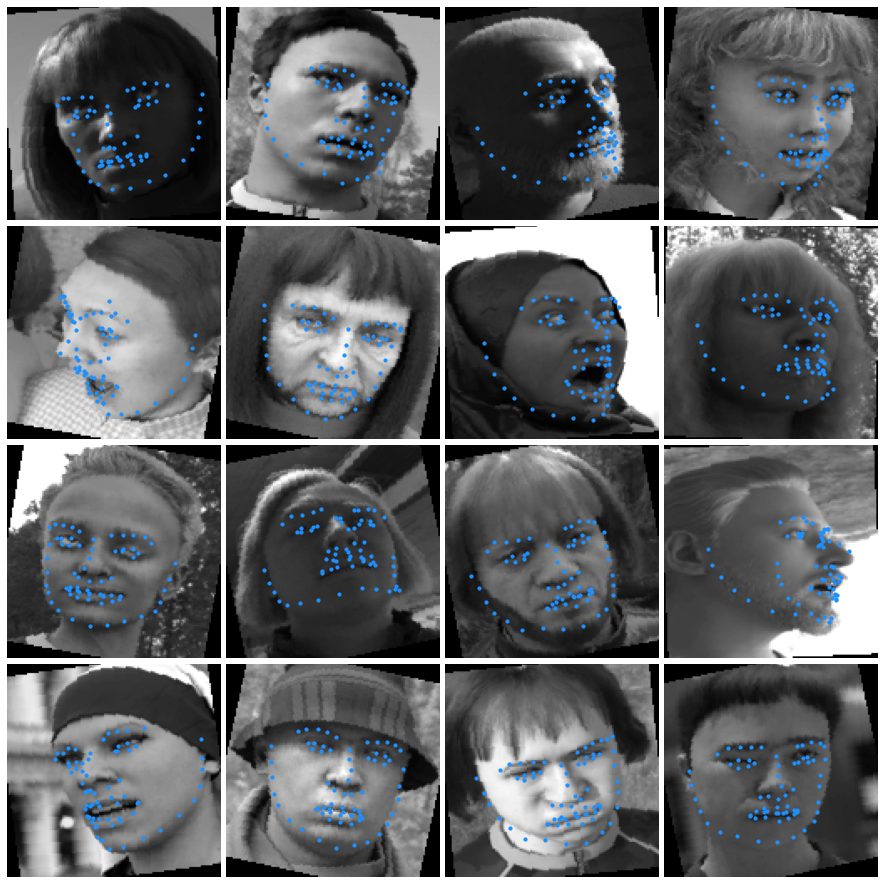

Epoch(14/100) -> Training Loss: 0.03477466 | Validation Loss: 0.02744239


Epoch(15/100):   0%|                                                                                          …

Validation sample predictions


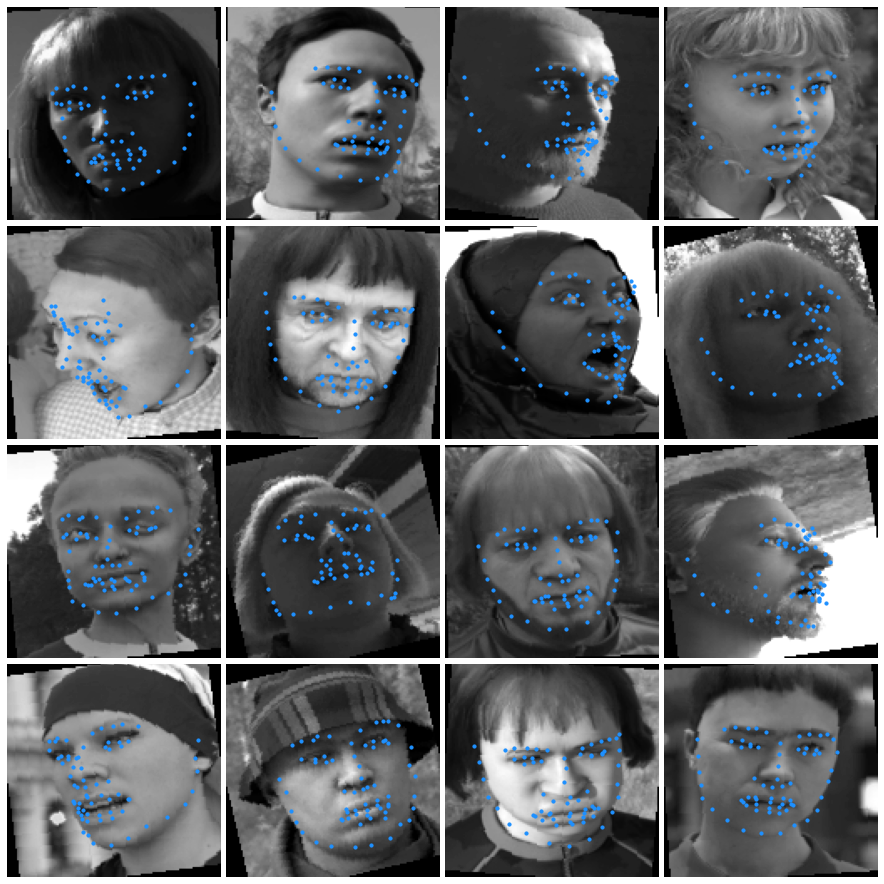

Saving model....................

Minimum Validation Loss of 0.0265 at epoch 14/100
Model Saved

Epoch(15/100) -> Training Loss: 0.03306017 | Validation Loss: 0.02652318


Epoch(16/100):   0%|                                                                                          …

Validation sample predictions


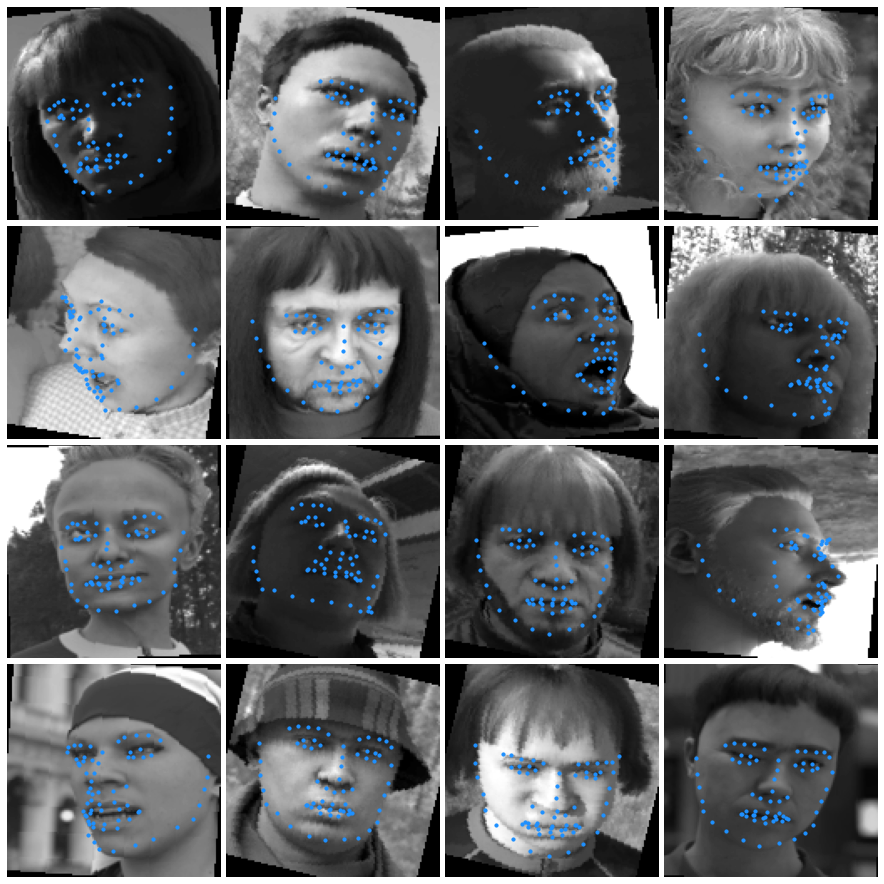

Epoch(16/100) -> Training Loss: 0.03262750 | Validation Loss: 0.02659689


Epoch(17/100):   0%|                                                                                          …

Validation sample predictions


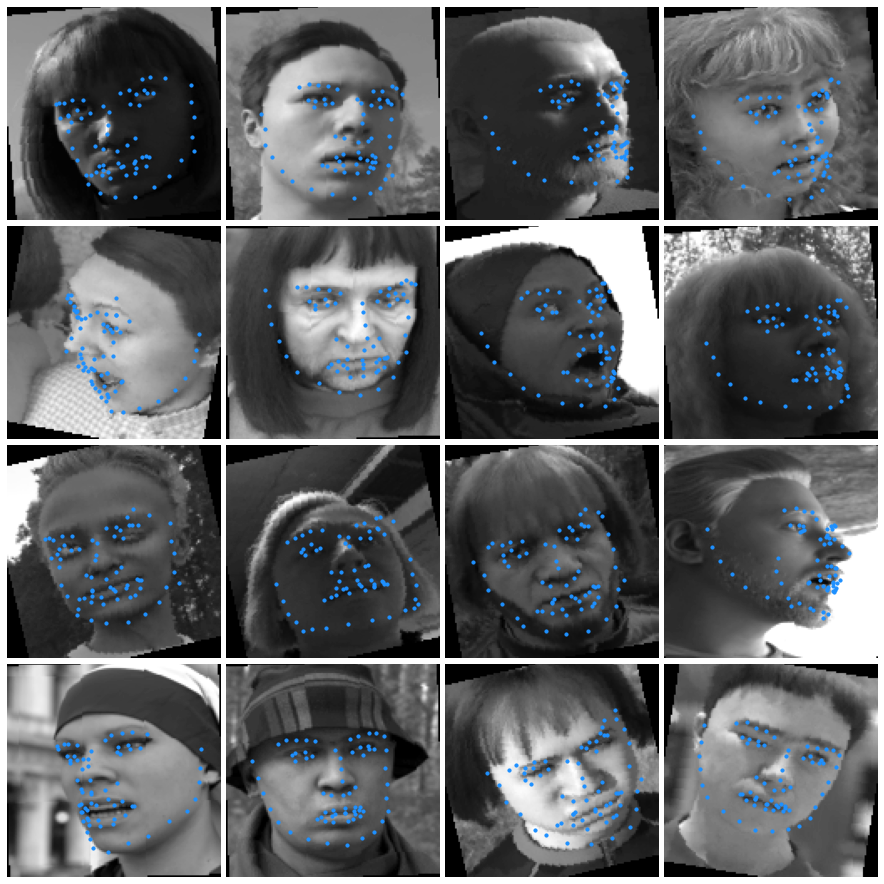

Epoch(17/100) -> Training Loss: 0.03109199 | Validation Loss: 0.02712252


Epoch(18/100):   0%|                                                                                          …

Validation sample predictions


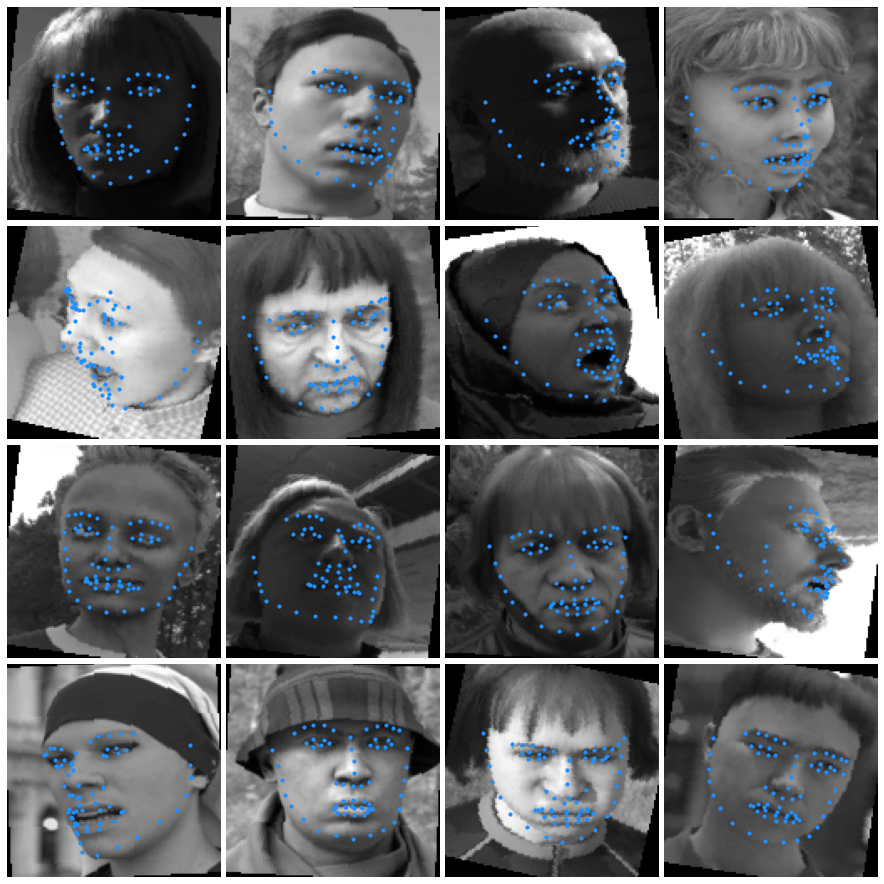

Saving model....................

Minimum Validation Loss of 0.0260 at epoch 17/100
Model Saved

Epoch(18/100) -> Training Loss: 0.03149287 | Validation Loss: 0.02601012


Epoch(19/100):   0%|                                                                                          …

Validation sample predictions


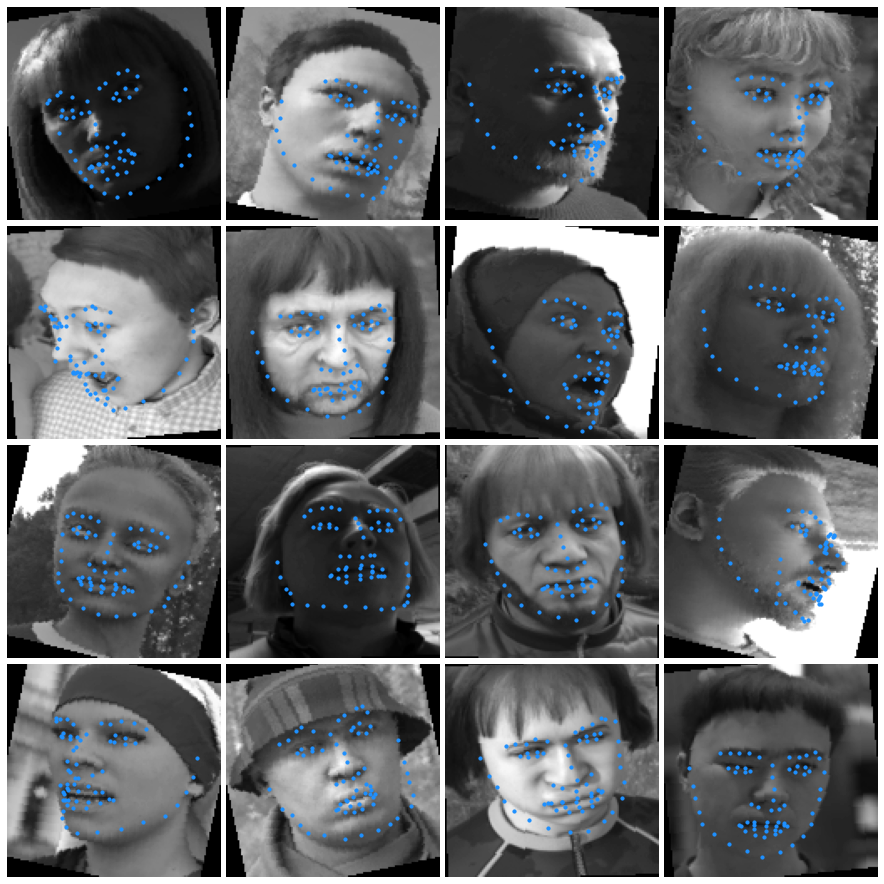

Epoch(19/100) -> Training Loss: 0.03110046 | Validation Loss: 0.02916944


Epoch(20/100):   0%|                                                                                          …

Validation sample predictions


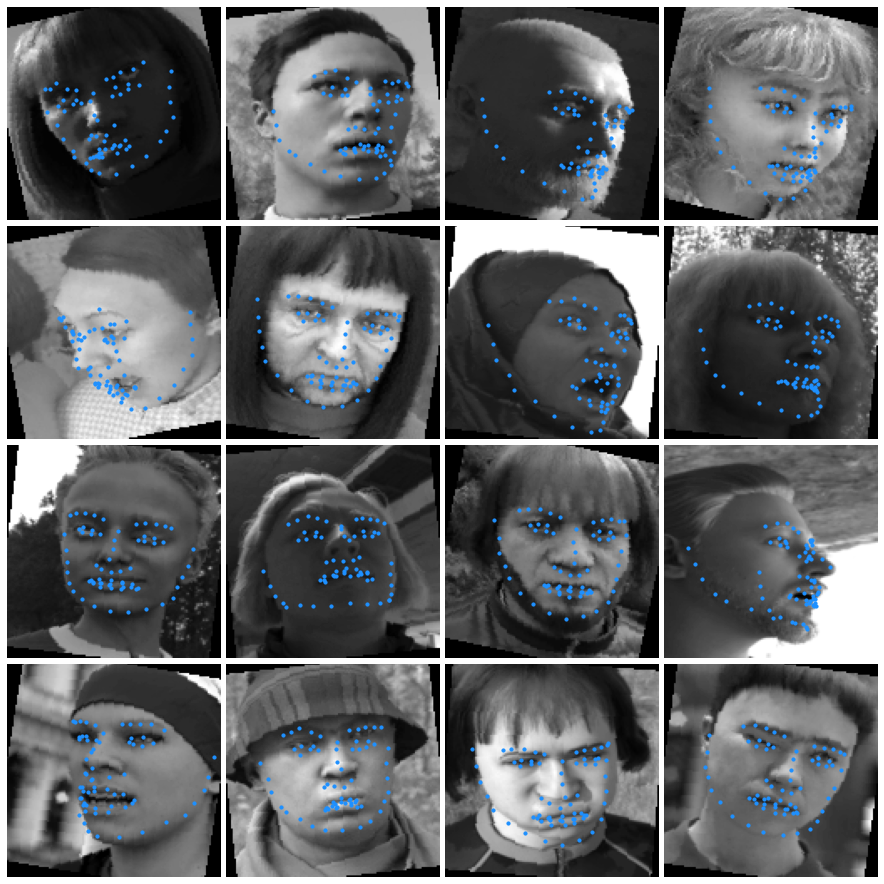

Epoch(20/100) -> Training Loss: 0.03141174 | Validation Loss: 0.02824693


Epoch(21/100):   0%|                                                                                          …

Validation sample predictions


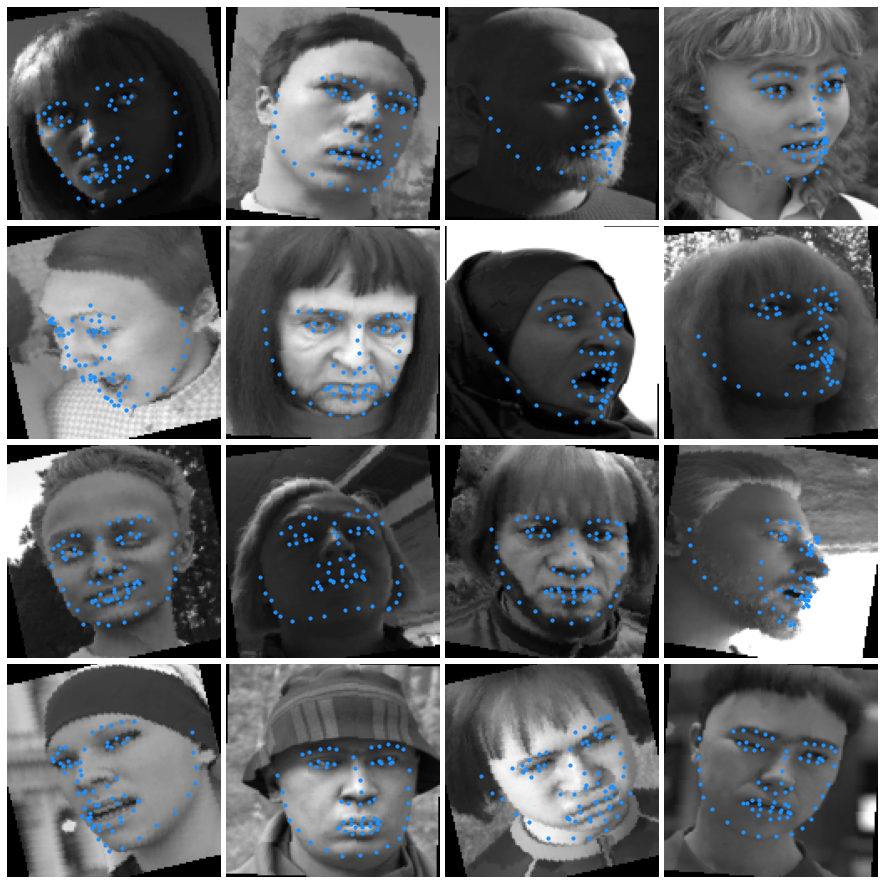

Saving model....................

Minimum Validation Loss of 0.0244 at epoch 20/100
Model Saved

Epoch(21/100) -> Training Loss: 0.03032105 | Validation Loss: 0.02443102


Epoch(22/100):   0%|                                                                                          …

Validation sample predictions


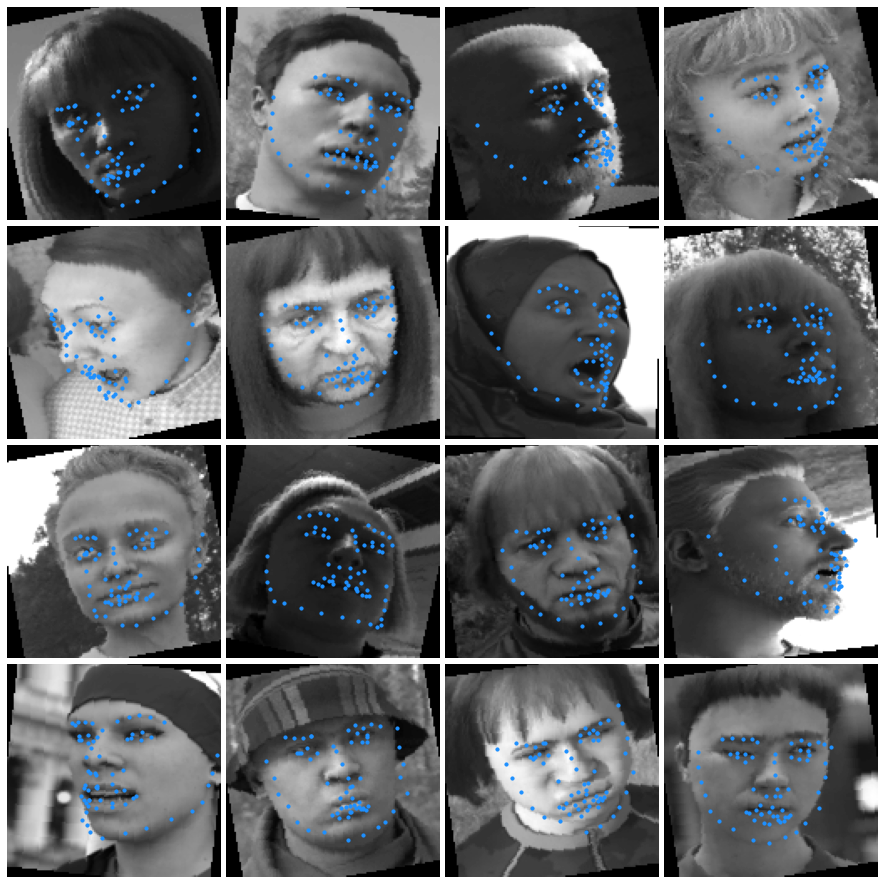

Epoch(22/100) -> Training Loss: 0.03030012 | Validation Loss: 0.02866564


Epoch(23/100):   0%|                                                                                          …

Validation sample predictions


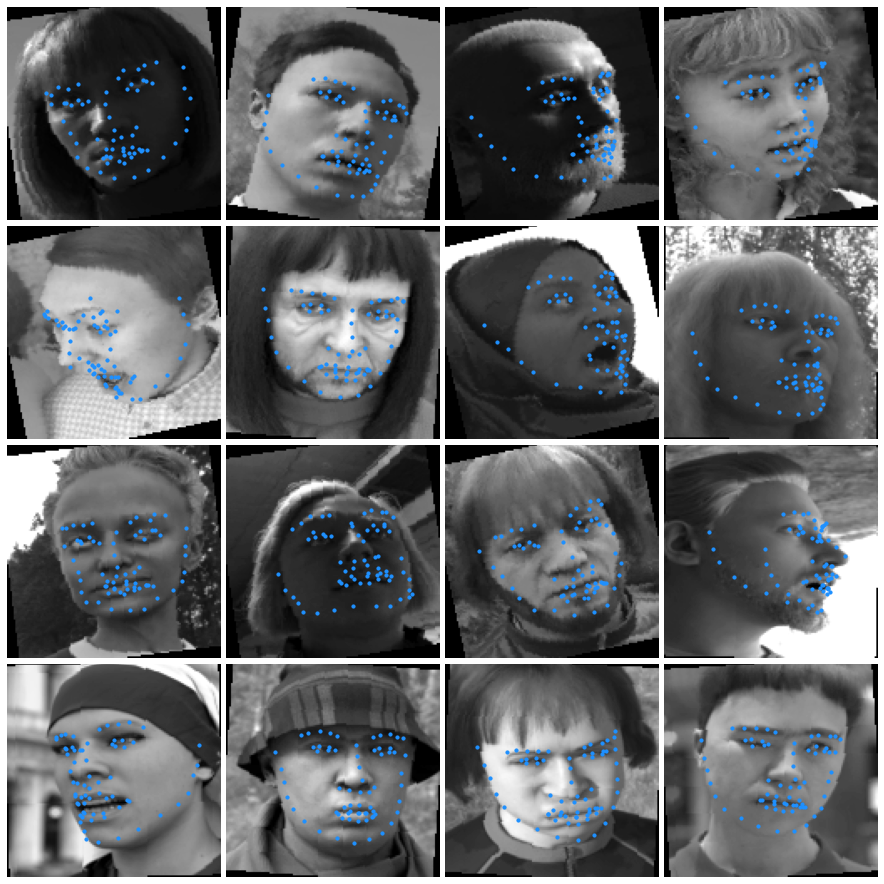

Epoch(23/100) -> Training Loss: 0.03065447 | Validation Loss: 0.02678422


Epoch(24/100):   0%|                                                                                          …

Validation sample predictions


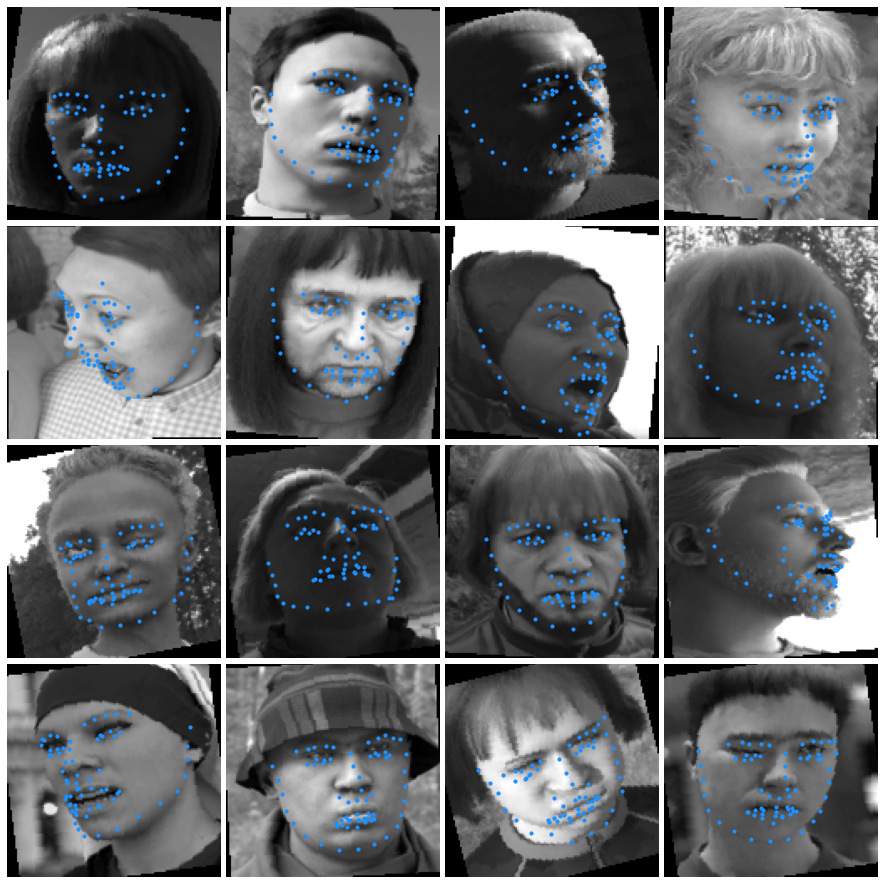

Epoch(24/100) -> Training Loss: 0.02873373 | Validation Loss: 0.02508989


Epoch(25/100):   0%|                                                                                          …

Validation sample predictions


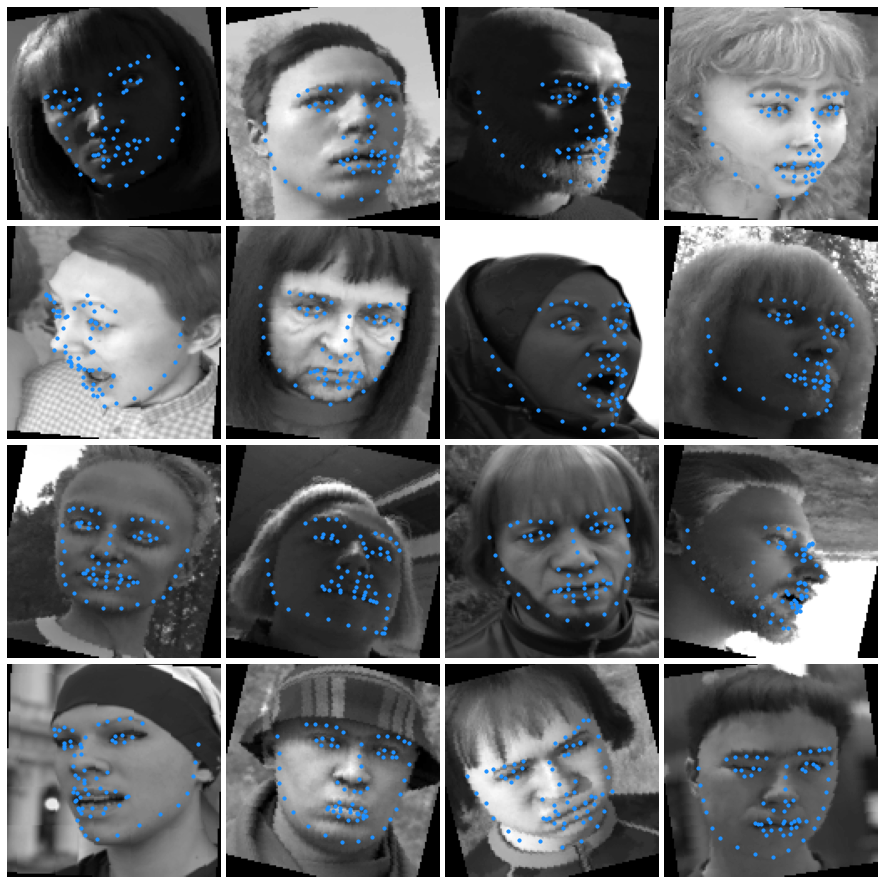

Saving model....................

Minimum Validation Loss of 0.0233 at epoch 24/100
Model Saved

Epoch(25/100) -> Training Loss: 0.02863095 | Validation Loss: 0.02328306


Epoch(26/100):   0%|                                                                                          …

Validation sample predictions


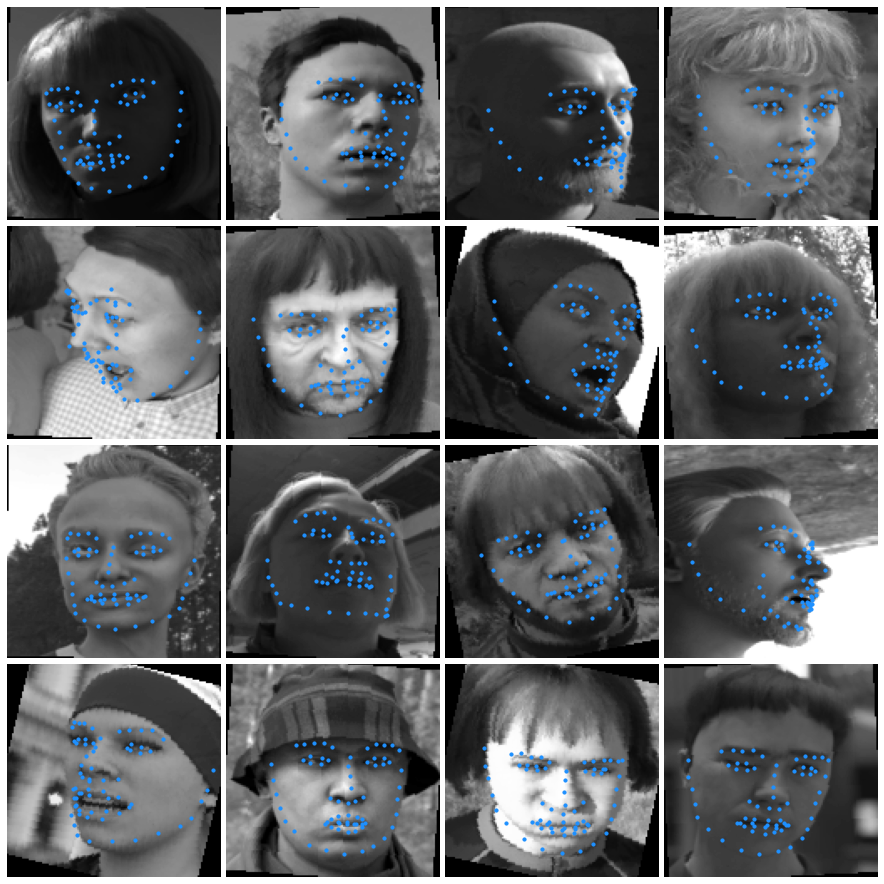

Epoch(26/100) -> Training Loss: 0.02872689 | Validation Loss: 0.02395919


Epoch(27/100):   0%|                                                                                          …

Validation sample predictions


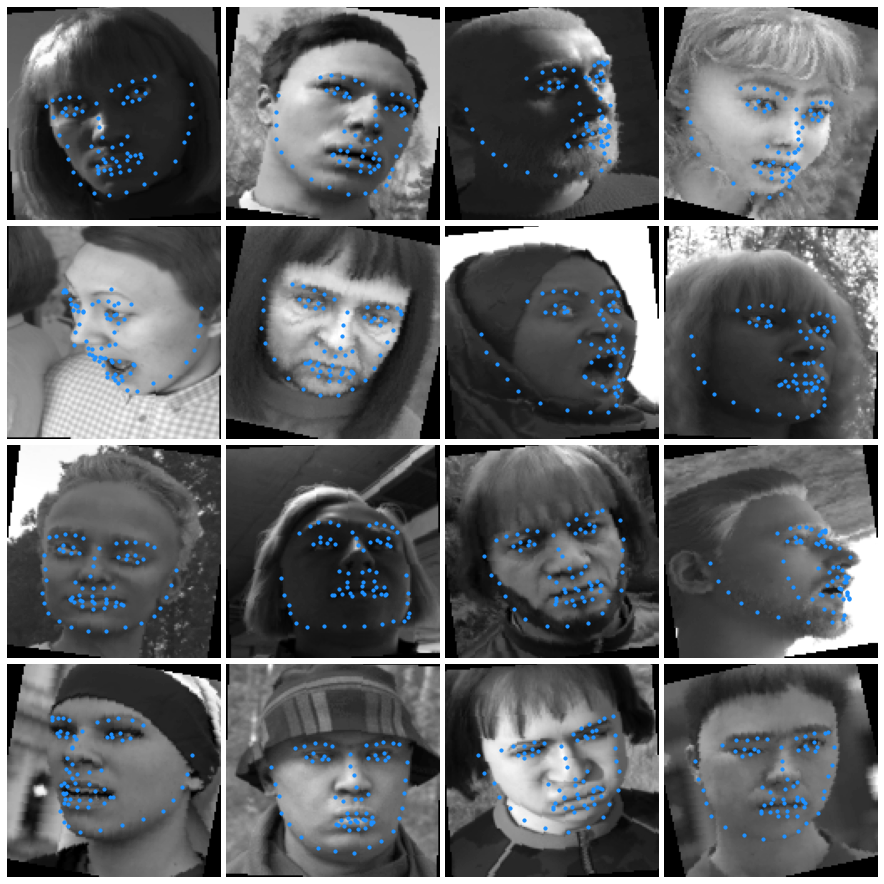

Epoch(27/100) -> Training Loss: 0.02716029 | Validation Loss: 0.02441475


Epoch(28/100):   0%|                                                                                          …

Validation sample predictions


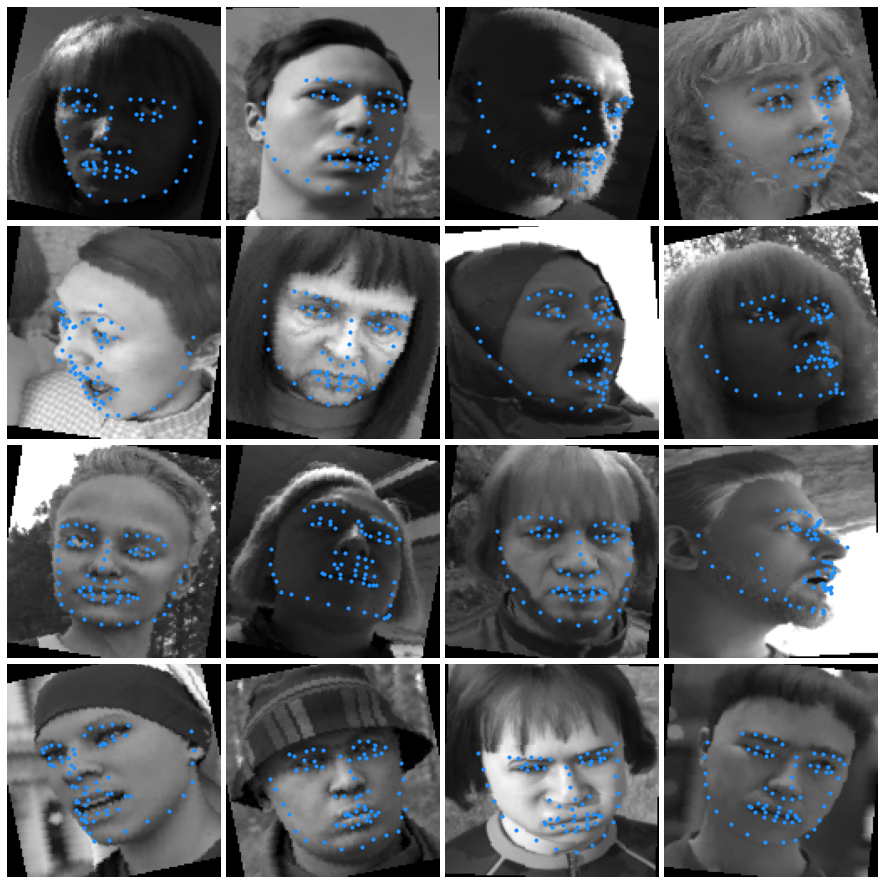

Epoch(28/100) -> Training Loss: 0.02769617 | Validation Loss: 0.02449489


Epoch(29/100):   0%|                                                                                          …

Validation sample predictions


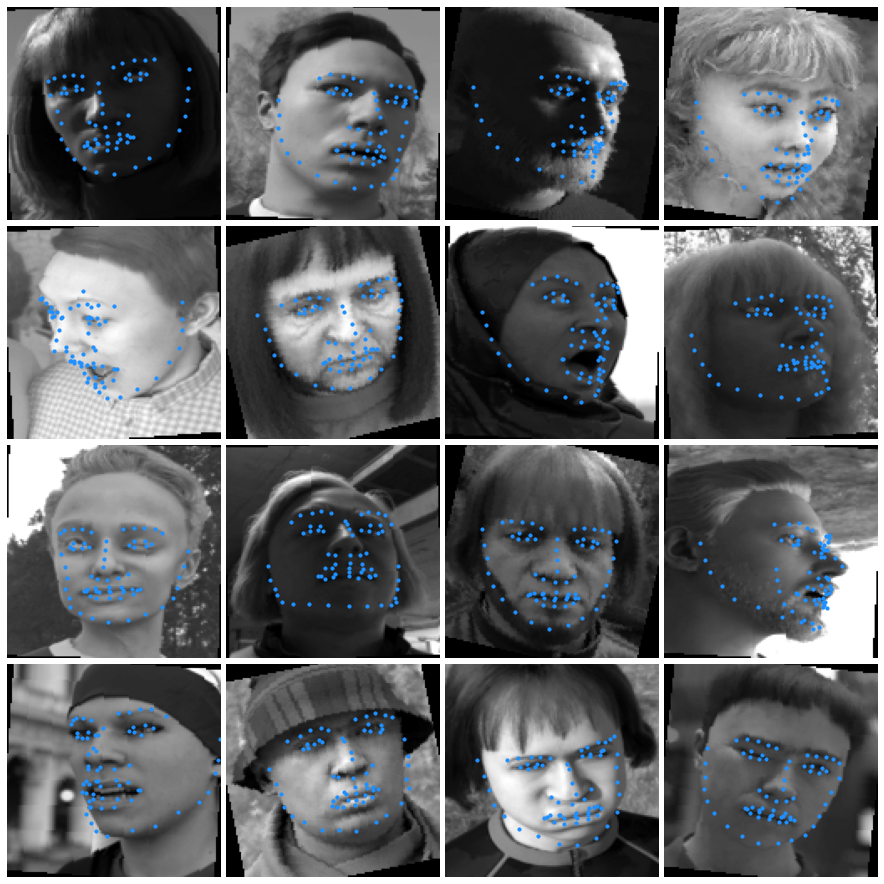

Epoch(29/100) -> Training Loss: 0.02708271 | Validation Loss: 0.02378927


Epoch(30/100):   0%|                                                                                          …

Validation sample predictions


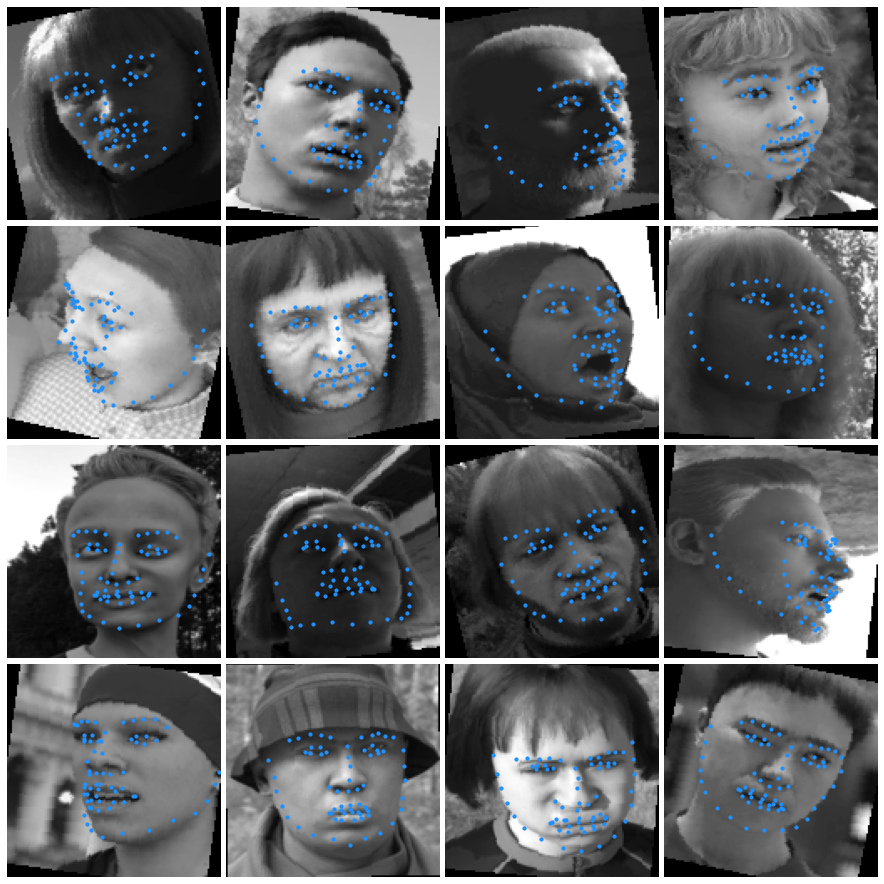

Epoch(30/100) -> Training Loss: 0.02590537 | Validation Loss: 0.02520715


Epoch(31/100):   0%|                                                                                          …

Validation sample predictions


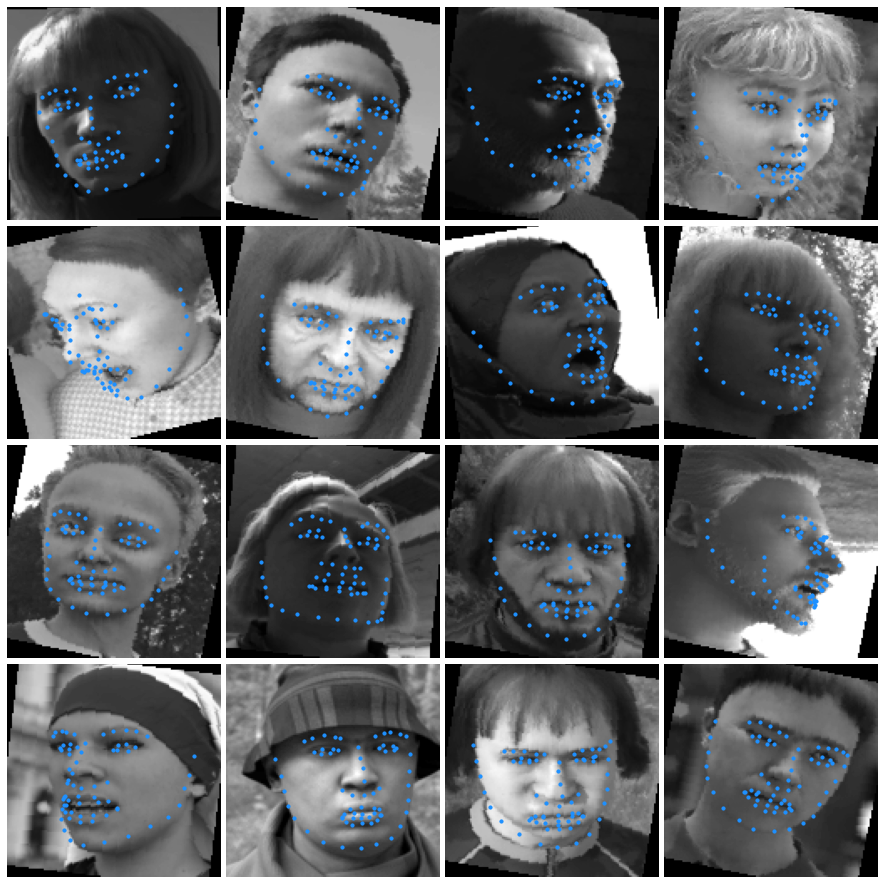

Saving model....................

Minimum Validation Loss of 0.0217 at epoch 30/100
Model Saved

Epoch(31/100) -> Training Loss: 0.02698326 | Validation Loss: 0.02170067


Epoch(32/100):   0%|                                                                                          …

Validation sample predictions


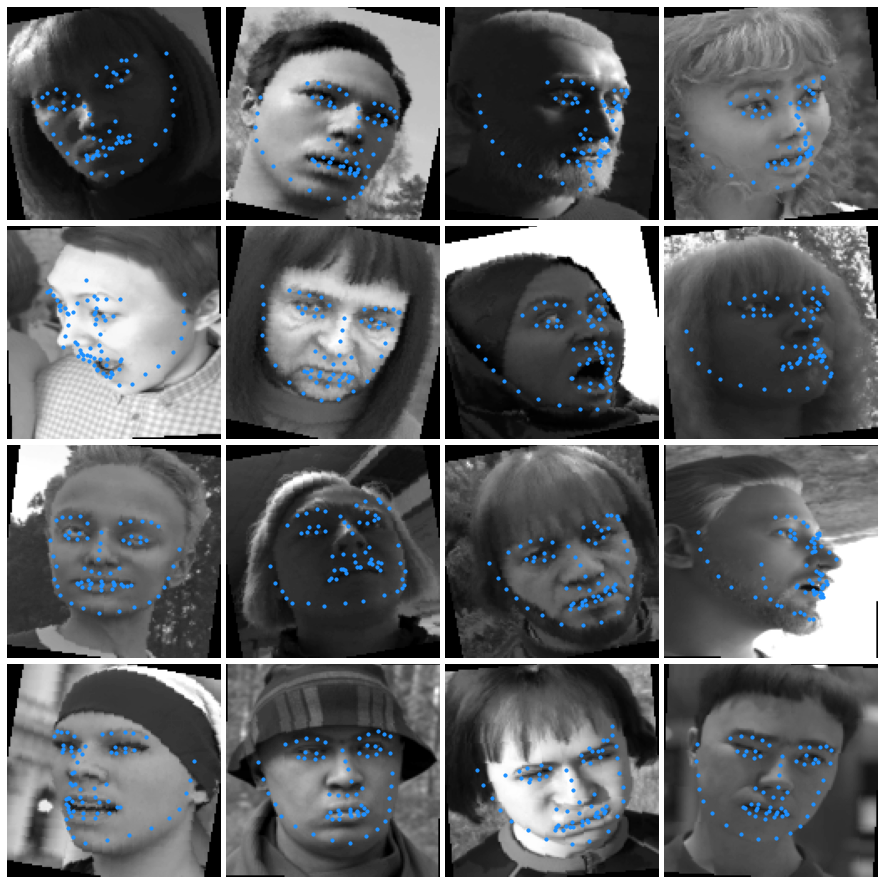

Epoch(32/100) -> Training Loss: 0.02753536 | Validation Loss: 0.02811245


Epoch(33/100):   0%|                                                                                          …

Validation sample predictions


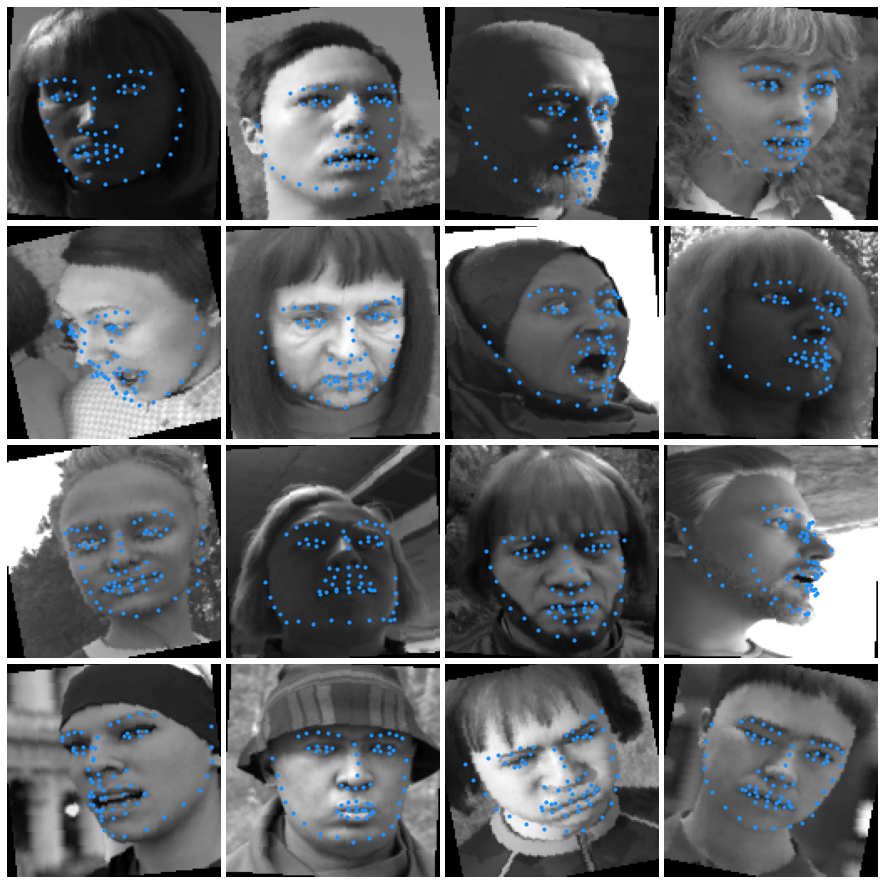

Epoch(33/100) -> Training Loss: 0.02965343 | Validation Loss: 0.02300314


Epoch(34/100):   0%|                                                                                          …

Validation sample predictions


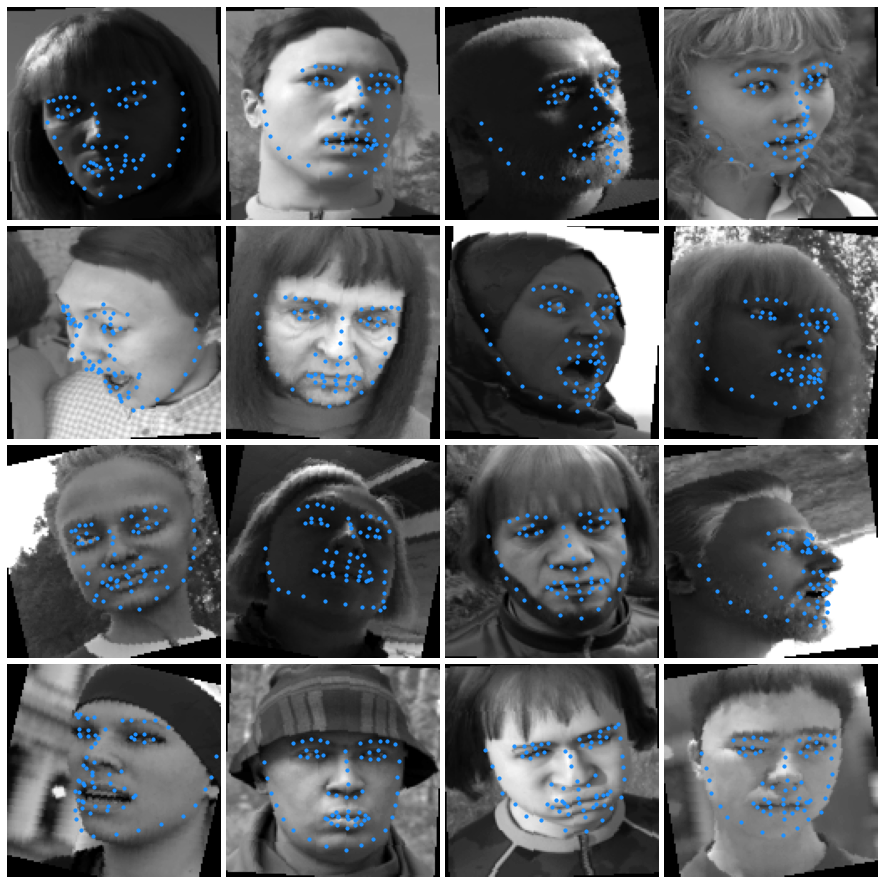

Epoch(34/100) -> Training Loss: 0.02706636 | Validation Loss: 0.02313932


Epoch(35/100):   0%|                                                                                          …

In [ ]:
epochs = 100
batches = len(train_data)
best_loss = np.inf
optimizer.zero_grad()

for epoch in range(epochs):
    cum_loss = 0.0

    model.train()
    for batch_index, (features, labels) in enumerate(tqdm(train_data, desc = f'Epoch({epoch + 1}/{epochs})', ncols = 800)):
        features = features.cuda()
        labels = labels.cuda()

        img_transformed = features
        outputs = model(img_transformed)

        #outputs = model(features)
        #loss = objective(outputs, labels)

        loss = objective(outputs, labels)

        loss.backward()

        optimizer.step()
        
        optimizer.zero_grad()

        cum_loss += loss.item()

    val_loss = validate(os.path.join('progress', f'epoch({str(epoch + 1).zfill(len(str(epochs)))}).jpg'))

    if val_loss < best_loss:
        best_loss = val_loss
        print('Saving model....................')
        #torch.save(model.state_dict(), 'model.pt')
        torch.save(model.state_dict(), '/content/face_landmarks.pth') 
        !cp /content/face_landmarks.pth /content/drive/MyDrive/CMPT732_Project/RESNET_50/face_landmarks.pth
        print("\nMinimum Validation Loss of {:.4f} at epoch {}/{}".format(best_loss, epoch + 1, epochs))
        print('Model Saved\n')

    print(f'Epoch({epoch + 1}/{epochs}) -> Training Loss: {cum_loss/batches:.8f} | Validation Loss: {val_loss:.8f}')

#Save the model in drive

In [ ]:
Save Model to Drive

In [ ]:
cp /content/face_landmarks.pth /content/drive/MyDrive/CMPT732_Project/RESNET_50/face_landmarks.pth

#Plotting the loss

In [ ]:
print(val_losses)

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
plt.title("Resnet-50-Training and Validation Loss")
plt.plot(val_losses,label="val")
plt.plot(train_losses,label="train")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.annotate("Learning_rate= 0.0001", (0,0), (0, -40),  fontsize=12, xycoords='axes fraction', textcoords='offset points', va='top')
plt.annotate("Batch size= "+str(len(train_data)), (0,0), (0, -60),  fontsize=12, xycoords='axes fraction', textcoords='offset points', va='top')
plt.annotate("Image dim = 128*128 ", (0,0), (0, -80),  fontsize=12, xycoords='axes fraction', textcoords='offset points', va='top')
plt.annotate("Total Sample Data= 10000", (0,0), (0, -100),  fontsize=12, xycoords='axes fraction', textcoords='offset points', va='top')

plt.legend()
plt.show()

#Testing

**copy reptrained model from drive**

In [ ]:
!cp /content/drive/MyDrive/CMPT732_Project/RESNET_50/face_landmarks.pth /content/face_landmarks.pth

**Init Test**

In [ ]:
import random
mtcnn = MTCNN()
model.load_state_dict(torch.load('/content/face_landmarks.pth', map_location = 'cpu'))


<All keys matched successfully>

In [ ]:
def preprocess_image(image):
    image = TF.to_pil_image(image)
    image = TF.resize(image, (128, 128))
    image=TF.to_grayscale(image)
    image = TF.to_tensor(image)
    image = (image - image.min())/(image.max() - image.min())
    image = (2 * image) - 1
    return image.unsqueeze(0)

def draw_landmarks_on_faces(image, faces_landmarks):
    image = image.copy()
    for landmarks, (left, top, height, width) in faces_landmarks:
        landmarks = landmarks.view(-1, 2)
        landmarks = (landmarks + 0.5)
        landmarks = landmarks.numpy()
        
        for i, (x, y) in enumerate(landmarks, 1):
            try:
                cv2.circle(image, (int((x * width) + left), int((y * height) + top)), 2, [40, 117, 255], -1)
            except:
                pass
    return image

def draw_landmarks_300_w(image, landmarks):
    image = image.copy()
    for p in landmarks:
        #print("------",image.shape,p,"-----")
        cv2.circle(image, (p[0], p[1]), 2, [0, 225, 0], -1)
    return image  

#Test on 300W Images

In [ ]:
!wget http://dlib.net/files/data/ibug_300W_large_face_landmark_dataset.tar.gz
!tar -xzf 'ibug_300W_large_face_landmark_dataset.tar.gz'
!rm -r 'ibug_300W_large_face_landmark_dataset.tar.gz'

--2022-12-17 21:19:32--  http://dlib.net/files/data/ibug_300W_large_face_landmark_dataset.tar.gz
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1798323356 (1.7G) [application/x-gzip]
Saving to: ‘ibug_300W_large_face_landmark_dataset.tar.gz’

ibug_300W_large_fac 100%[===================>]   1.67G  60.5MB/s    in 15s     

2022-12-17 21:19:47 (118 MB/s) - ‘ibug_300W_large_face_landmark_dataset.tar.gz’ saved [1798323356/1798323356]



In [ ]:
from skimage import io

@torch.no_grad()
def inference(frame):
    boxes, probs = mtcnn.detect(frame, landmarks=False)
    #print("boxes....",boxes)

    outputs = []
    if boxes is  None:
        return draw_landmarks_on_faces(frame, outputs)

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    for (i, box) in enumerate(boxes):
        x=int(float(box[0]))
        y=int(float(box[1]))
        w=int(float(box[2]))-x
        h=int(float(box[3]))-y

        x=int(x-w/6)
        y=int(y-h/6)
        w=int(w+w/3)
        h=int(h+h/3)
        if x<0:
          x=0
        if y<0:
          y=0
        if x+w >frame.shape[1]:
          w=frame.shape[1]-x
        if y+h >frame.shape[0]:
          h=frame.shape[0]-y

        crop_img = frame[y: y + h, x: x + w]
        #plt.figure(figsize = (11, 11))
        #plt.imshow(crop_img) 
        preprocessed_image = preprocess_image(crop_img)
        print(preprocessed_image.shape)
        landmarks_predictions = model( preprocessed_image.cuda())
        #landmarks_predictions = model(preprocessed_image)

        outputs.append((landmarks_predictions.cpu(), (x, y, h, w)))
        visualize_image(preprocessed_image[0], landmarks_predictions.cpu())

    return draw_landmarks_on_faces(frame, outputs)

torch.Size([1, 1, 128, 128])


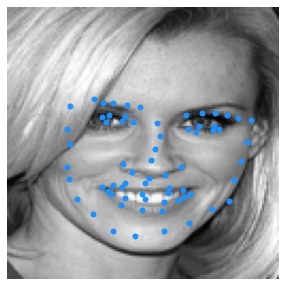

torch.Size([1, 1, 128, 128])


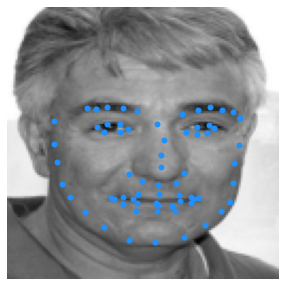

torch.Size([1, 1, 128, 128])


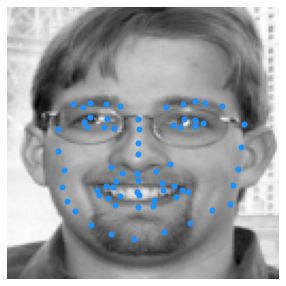

torch.Size([1, 1, 128, 128])


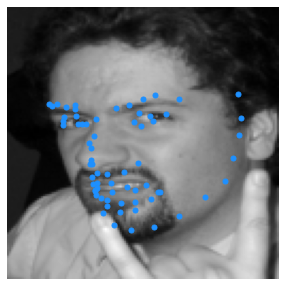

torch.Size([1, 1, 128, 128])


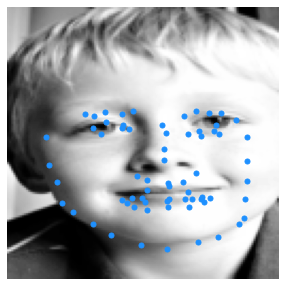

torch.Size([1, 1, 128, 128])


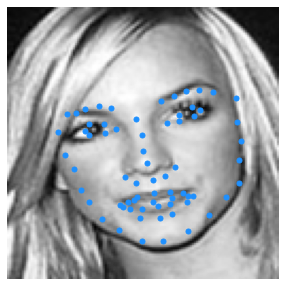

torch.Size([1, 1, 128, 128])


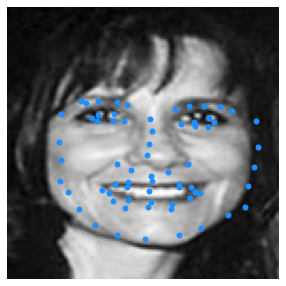

torch.Size([1, 1, 128, 128])


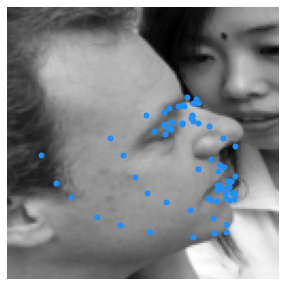

torch.Size([1, 1, 128, 128])


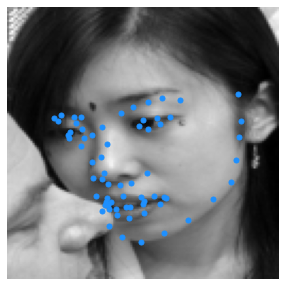

torch.Size([1, 1, 128, 128])


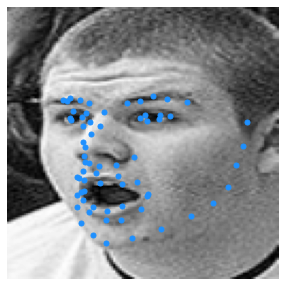

torch.Size([1, 1, 128, 128])


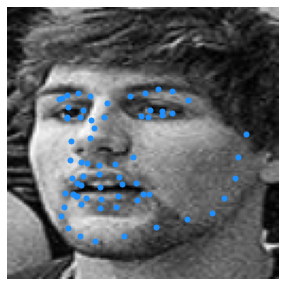

torch.Size([1, 1, 128, 128])


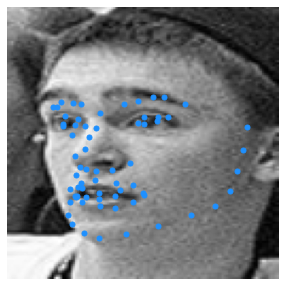

torch.Size([1, 1, 128, 128])


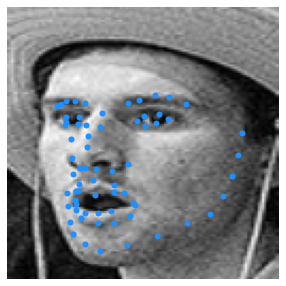

torch.Size([1, 1, 128, 128])


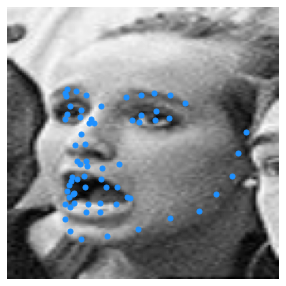

torch.Size([1, 1, 128, 128])


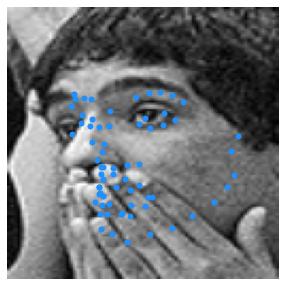

torch.Size([1, 1, 128, 128])


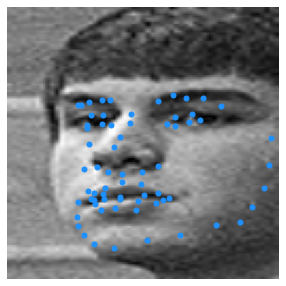

torch.Size([1, 1, 128, 128])


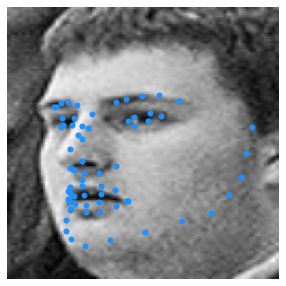

torch.Size([1, 1, 128, 128])


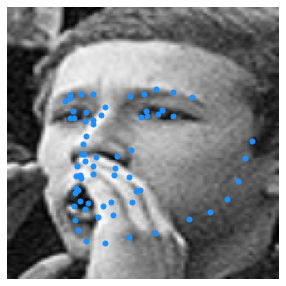

torch.Size([1, 1, 128, 128])


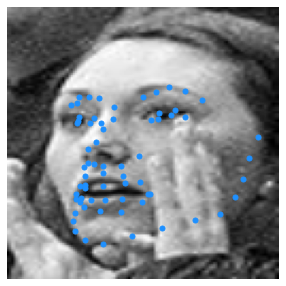

torch.Size([1, 1, 128, 128])


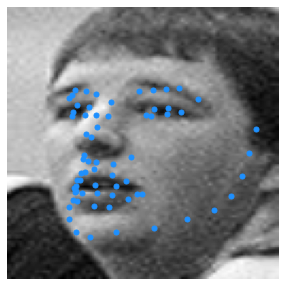

torch.Size([1, 1, 128, 128])


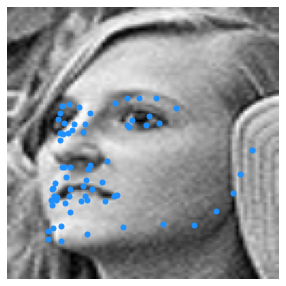

torch.Size([1, 1, 128, 128])


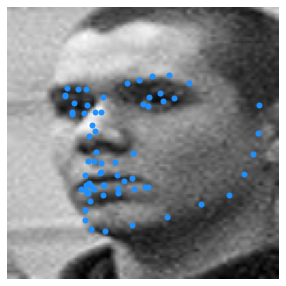

torch.Size([1, 1, 128, 128])


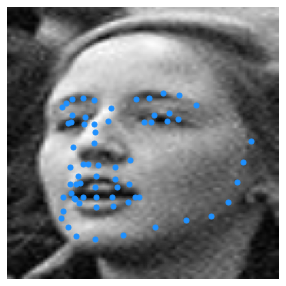

torch.Size([1, 1, 128, 128])


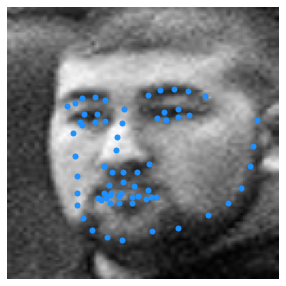

torch.Size([1, 1, 128, 128])


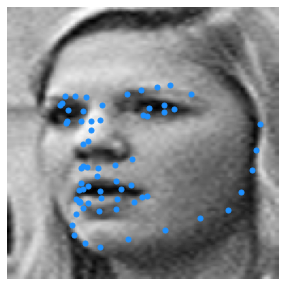

torch.Size([1, 1, 128, 128])


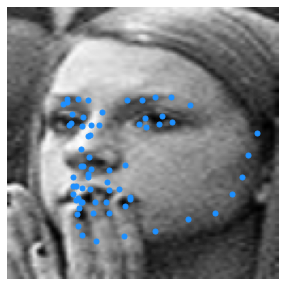

torch.Size([1, 1, 128, 128])


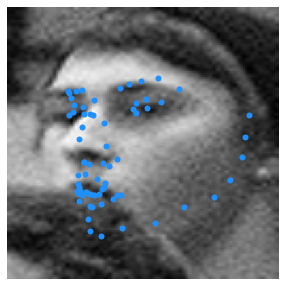

torch.Size([1, 1, 128, 128])


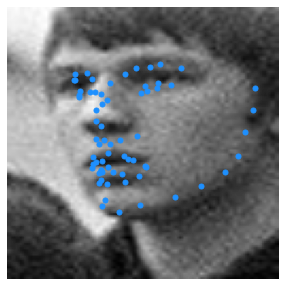

torch.Size([1, 1, 128, 128])


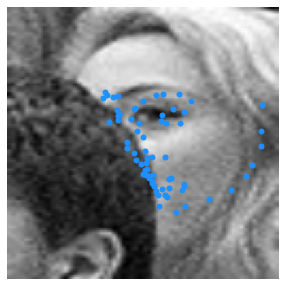

torch.Size([1, 1, 128, 128])


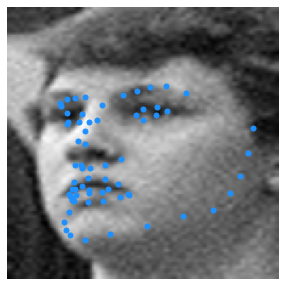

torch.Size([1, 1, 128, 128])


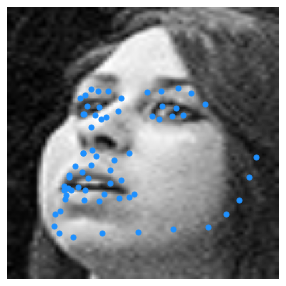

torch.Size([1, 1, 128, 128])


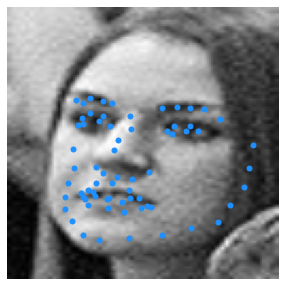

torch.Size([1, 1, 128, 128])


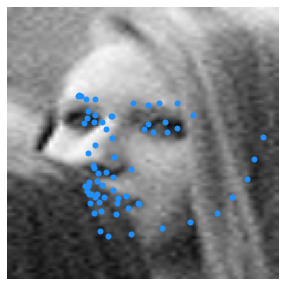

torch.Size([1, 1, 128, 128])


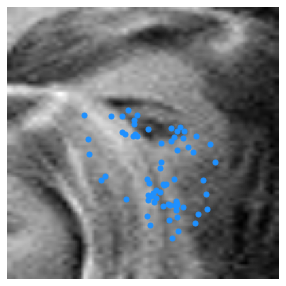

torch.Size([1, 1, 128, 128])


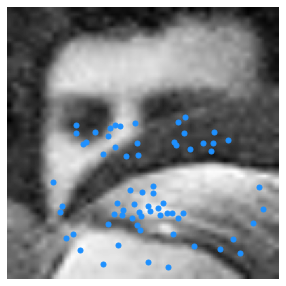

torch.Size([1, 1, 128, 128])


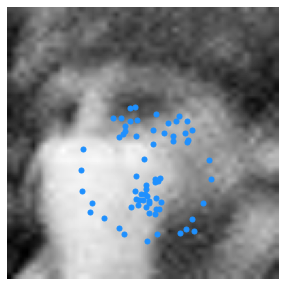

torch.Size([1, 1, 128, 128])


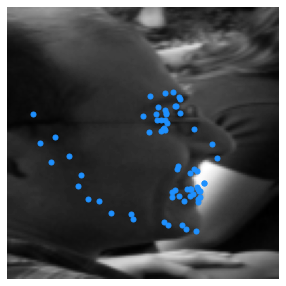

torch.Size([1, 1, 128, 128])


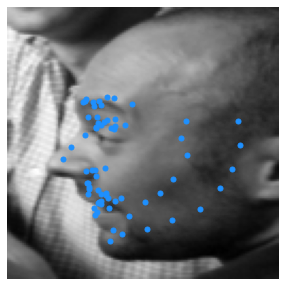

torch.Size([1, 1, 128, 128])


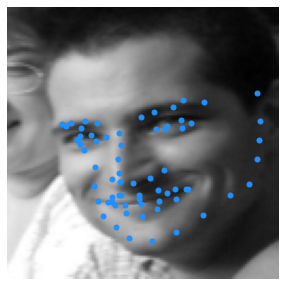

torch.Size([1, 1, 128, 128])


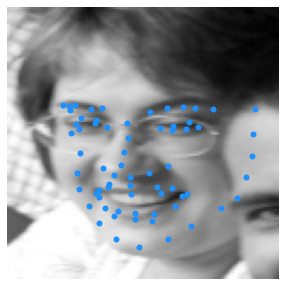

torch.Size([1, 1, 128, 128])


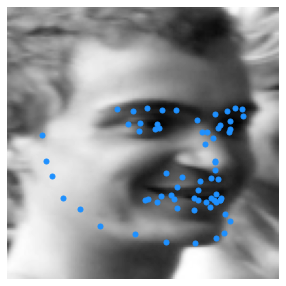

torch.Size([1, 1, 128, 128])


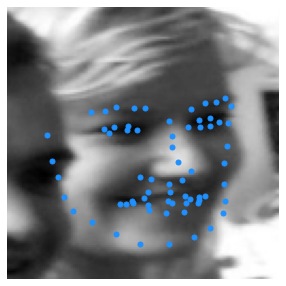

torch.Size([1, 1, 128, 128])


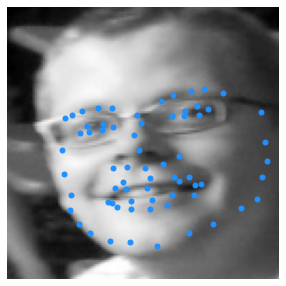

torch.Size([1, 1, 128, 128])


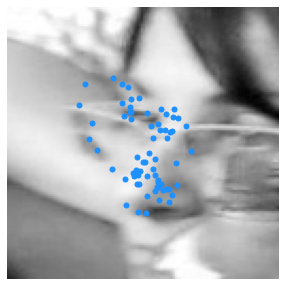

torch.Size([1, 1, 128, 128])


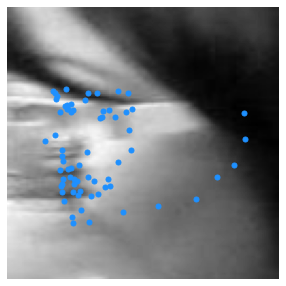

torch.Size([1, 1, 128, 128])


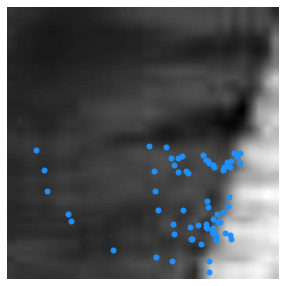

torch.Size([1, 1, 128, 128])


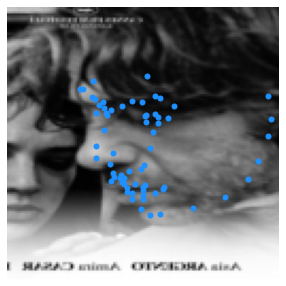

torch.Size([1, 1, 128, 128])


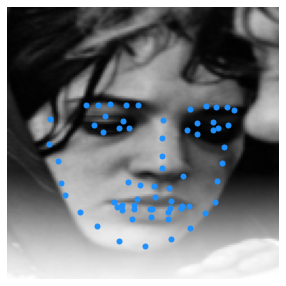

torch.Size([1, 1, 128, 128])


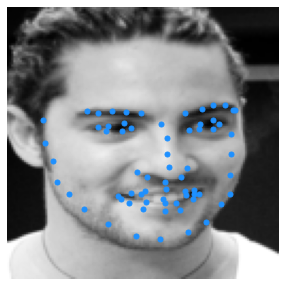

In [ ]:
def test_on_300_W():

    outputs = []
    root_dir = 'ibug_300W_large_face_landmark_dataset'  
    tree = ElementTree.parse(os.path.join(root_dir, f'labels_ibug_300W_test.xml'))
    root = tree.getroot()
    landmarks_300_all=[]
    filename_all=[]
    for filename in root[2]:
      filename_all.append(os.path.join(root_dir, filename.attrib['file']))
      landmark = []
      for num in range(68):
                x_coordinate = int(filename[0][num].attrib['x'])
                y_coordinate = int(filename[0][num].attrib['y'])
                landmark.append([x_coordinate, y_coordinate])
      landmarks_300_all.append(landmark)

    #test_list = random.choices(filename_all, k=1)
    # print(test_list)
    #run for first 10 images
    for i in range(2):
      random_idx = random.choice(range(len(filename_all))) #get random index for the file
      frame = io.imread(filename_all[random_idx])
      output = inference(frame)
      output=draw_landmarks_300_w(output, landmarks_300_all[random_idx])
      outputs.append(output)

    return outputs

def run_test_on_300_W():
    outputs = test_on_300_W()  
    for output in outputs:
         plt.figure(figsize = (11, 11))
         plt.imshow(output)

run_test_on_300_W()

#Test on 300VW

In [ ]:
from skimage import io

@torch.no_grad()
def inference_video(frame):
    boxes, probs = mtcnn.detect(frame, landmarks=False)
    #print("boxes....",boxes)
    outputs = []

    if boxes is  None:
        return draw_landmarks_on_faces(frame, outputs)

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    for (i, box) in enumerate(boxes):
        x=int(float(box[0]))
        y=int(float(box[1]))
        w=int(float(box[2]))-x
        h=int(float(box[3]))-y

        x=int(x-w/6)
        y=int(y-h/6)
        w=int(w+w/3)
        h=int(h+h/3)
        if x<0:
          x=0
        if y<0:
          y=0
        if x+w >frame.shape[1]:
          w=frame.shape[1]-x
        if y+h >frame.shape[0]:
          h=frame.shape[0]-y

        crop_img = frame[y: y + h, x: x + w]
        #plt.figure(figsize = (11, 11))
        #plt.imshow(crop_img) 
        preprocessed_image = preprocess_image(crop_img)
        #print(preprocessed_image.shape)
        landmarks_predictions = model( preprocessed_image.cuda())
        #landmarks_predictions = model(preprocessed_image)

        outputs.append((landmarks_predictions.cpu(), (x, y, h, w)))
        #visualize_image(preprocessed_image[0], landmarks_predictions.cpu())

    return draw_landmarks_on_faces(frame, outputs)

In [ ]:
from google.colab.patches import cv2_imshow

import cv2
fourcc = cv2.VideoWriter_fourcc(*'MP4V')

out_vidoe_name="224_processed.mp4"
vid_capture = cv2.VideoCapture('/content/drive/MyDrive/300VW/224.avi')

video_writer = cv2.VideoWriter(out_vidoe_name,fourcc, 20.0,(int(vid_capture.get(3)),int(vid_capture.get(4))))


 
if (vid_capture.isOpened() == False):
  print("Error opening the video file")

fps=vid_capture.get(5)
print("FPS: ",fps)

frame_count = vid_capture.get(7)
print('Frame count : ',frame_count)
c=0   
while(vid_capture.isOpened()):
  # vid_capture.read() methods returns a tuple, first element is a bool 
  # and the second is frame
  ret, frame = vid_capture.read()
  if ret == True:
    output = inference_video(frame)
    video_writer.write(output)
    c=c+1
    if c%fps==0:
      print(int((c/frame_count)*100),"% compleated...") 
    
  else:
    break
 
# Release the video capture object
vid_capture.release()   
video_writer.release()


**Copy video to drive if required**

In [ ]:
!cp 224_processed.mp4 /content/drive/MyDrive/300VW/processed_videos/RESNET_50/224.avi #change path accordingly

or download processed video

In [ ]:
from google.colab import files
files.download(out_vidoe_name)

#Webcam Test section

In [ ]:
from IPython.display import display, Javascript, Image
from google.colab.output import eval_js
from base64 import b64decode, b64encode
import cv2
import numpy as np
import PIL
import html
import time
import io



# function to convert the JavaScript object into an OpenCV image
def js_to_image(js_reply):
  """
  Params:
          js_reply: JavaScript object containing image from webcam
  Returns:
          img: OpenCV BGR image
  """

  # decode base64 image
  image_bytes = b64decode(js_reply.split(',')[1])
  # convert bytes to numpy array
  jpg_as_np = np.frombuffer(image_bytes, dtype=np.uint8)
  # decode numpy array into OpenCV BGR image
  img = cv2.imdecode(jpg_as_np, flags=1)

  return img

# function to convert OpenCV Rectangle bounding box image into base64 byte string to be overlayed on video stream
def bbox_to_bytes(bbox_array):
  """
  Params:
          bbox_array: Numpy array (pixels) containing rectangle to overlay on video stream.
  Returns:
        bytes: Base64 image byte string
  """
  # convert array into PIL image
  bbox_PIL = PIL.Image.fromarray(bbox_array, 'RGBA')
  iobuf = io.BytesIO()
  # format bbox into png for return
  bbox_PIL.save(iobuf, format='png')
  # format return string
  bbox_bytes = 'data:image/png;base64,{}'.format((str(b64encode(iobuf.getvalue()), 'utf-8')))

  return bbox_bytes

  # JavaScript to properly create our live video stream using our webcam as input
def video_stream():
  js = Javascript('''
    var video;
    var div = null;
    var stream;
    var captureCanvas;
    var imgElement;
    var labelElement;
    
    var pendingResolve = null;
    var shutdown = false;
    
    function removeDom() {
       stream.getVideoTracks()[0].stop();
       video.remove();
       div.remove();
       video = null;
       div = null;
       stream = null;
       imgElement = null;
       captureCanvas = null;
       labelElement = null;
    }
    
    function onAnimationFrame() {
      if (!shutdown) {
        window.requestAnimationFrame(onAnimationFrame);
      }
      if (pendingResolve) {
        var result = "";
        if (!shutdown) {
          captureCanvas.getContext('2d').drawImage(video, 0, 0, 640, 480);
          result = captureCanvas.toDataURL('image/jpeg', 0.8)
        }
        var lp = pendingResolve;
        pendingResolve = null;
        lp(result);
      }
    }
    
    async function createDom() {
      if (div !== null) {
        return stream;
      }

      video_width=720
      video_height=640
      div = document.createElement('div');
      div.style.border = '2px solid black';
      div.style.padding = '3px';
      div.style.width = '100%';
      div.style.maxWidth = '600px';
      document.body.appendChild(div);
      
      const modelOut = document.createElement('div');
      modelOut.innerHTML = "<span>Status:</span>";
      labelElement = document.createElement('span');
      labelElement.innerText = 'No data';
      labelElement.style.fontWeight = 'bold';
      modelOut.appendChild(labelElement);
      div.appendChild(modelOut);
           
      video = document.createElement('video');
      video.style.display = 'block';
      video.width = div.clientWidth - 6;
      video.setAttribute('playsinline', '');
      video.onclick = () => { shutdown = true; };
      stream = await navigator.mediaDevices.getUserMedia(
          {video: { facingMode: "environment"}});
      div.appendChild(video);

      imgElement = document.createElement('img');
      imgElement.style.position = 'absolute';
      imgElement.style.zIndex = 1;
      imgElement.onclick = () => { shutdown = true; };
      div.appendChild(imgElement);
      
      const instruction = document.createElement('div');
      instruction.innerHTML = 
          '<span style="color: red; font-weight: bold;">' +
          'When finished, click here or on the video to stop this demo</span>';
      div.appendChild(instruction);
      instruction.onclick = () => { shutdown = true; };
      
      video.srcObject = stream;
      await video.play();

      captureCanvas = document.createElement('canvas');
      captureCanvas.width = video_width; //video.videoWidth;
      captureCanvas.height = video_height; //video.videoHeight;
      window.requestAnimationFrame(onAnimationFrame);
      
      return stream;
    }
    async function stream_frame(label, imgData) {
      if (shutdown) {
        removeDom();
        shutdown = false;
        return '';
      }

      var preCreate = Date.now();
      stream = await createDom();
      
      var preShow = Date.now();
      if (label != "") {
        labelElement.innerHTML = label;
      }
            
      if (imgData != "") {
        var videoRect = video.getClientRects()[0];
        imgElement.style.top = videoRect.top + "px";
        imgElement.style.left = videoRect.left + "px";
        imgElement.style.width = videoRect.width + "px";
        imgElement.style.height = videoRect.height + "px";
        imgElement.src = imgData;
      }
      
      var preCapture = Date.now();
      var result = await new Promise(function(resolve, reject) {
        pendingResolve = resolve;
      });
      shutdown = false;
      
      return {'create': preShow - preCreate, 
              'show': preCapture - preShow, 
              'capture': Date.now() - preCapture,
              'img': result};
    }
    ''')

  display(js)
  
def video_frame(label, bbox):
  data = eval_js('stream_frame("{}", "{}")'.format(label, bbox))
  return data

In [ ]:

@torch.no_grad()
def inference_webcam(frame):
    boxes, probs = mtcnn.detect(frame, landmarks=False)
    #print("boxes....",boxes)
    outputs = []

    if boxes is  None:
        return outputs



    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    for (i, box) in enumerate(boxes):
        x=int(float(box[0]))
        y=int(float(box[1]))
        w=int(float(box[2]))-x
        h=int(float(box[3]))-y

        x=int(x-w/6)
        y=int(y-h/6)
        w=int(w+w/3)
        h=int(h+h/3)
        if x<0:
          x=0
        if y<0:
          y=0
        if x+w >frame.shape[1]:
          w=frame.shape[1]-x
        if y+h >frame.shape[0]:
          h=frame.shape[0]-y

        crop_img = frame[y: y + h, x: x + w]
        #plt.figure(figsize = (11, 11))
        #plt.imshow(crop_img) 
        preprocessed_image = preprocess_image(crop_img)
        landmarks_predictions = model(preprocessed_image.cuda())
        #landmarks_predictions = model(preprocessed_image)

        outputs.append((landmarks_predictions.cpu(), (x, y, h, w)))

    #print(outputs)
    return outputs
    #return draw_landmarks_on_faces(bbox_array, outputs)

In [ ]:
# start streaming video from webcam
def start_video_demo():
  video_width=720
  video_height=640
  video_stream()
  # label for video
  label_html = 'Capturing...'
  # initialze bounding box to empty
  bbox = ''
  count = 0 
  while True:
      js_reply = video_frame(label_html, bbox)
      if not js_reply:
          break

      # convert JS response to OpenCV Image
      img = js_to_image(js_reply["img"])
      #print(img.shape)

      # create transparent overlay for drawing dot
      bbox_array = np.zeros([video_height,video_width,4], dtype=np.uint8)

      faces_landmarks = inference_webcam(img)
      #print(faces_landmarks)
      for landmarks, (left, top, height, width) in faces_landmarks:
        landmarks = landmarks.view(-1, 2)
        landmarks = (landmarks + 0.5)
        landmarks = landmarks.numpy()
        
        for i, (x, y) in enumerate(landmarks, 1):
            try:
                bbox_array = cv2.circle(bbox_array, (int((x * width) + left), int((y * height) + top)), 2, [40, 117, 255], -1)
            except:
                pass
      
      # get face region coordinates
      #for (x,y,w,h) in faces:
      #  bbox_array = cv2.rectangle(bbox_array,(x,y),(x+w,y+h),(255,0,0),2)
      
      bbox_array[:,:,3] = (bbox_array.max(axis = 2) > 0 ).astype(int) * 255
      # convert overlay of bbox into bytes
      bbox_bytes = bbox_to_bytes(bbox_array)
      # update bbox so next frame gets new overlay
      bbox = bbox_bytes



In [ ]:
start_video_demo()

<IPython.core.display.Javascript object>